**Deteksi dengan Violation**

In [ ]:
import os
import subprocess
import torch
import librosa
import numpy as np
import cv2
import dlib
import soundfile as sf
from pydub import AudioSegment
from pydub.effects import normalize
import noisereduce as nr
import torchvision.transforms as T

transform = T.Compose([
    T.ToPILImage(),
    T.Resize((224, 224)),
    T.ToTensor()
])

def extract_mouth(frame, landmarks):
    x = landmarks[48:68, 0]
    y = landmarks[48:68, 1]
    x1, x2 = np.min(x), np.max(x)
    y1, y2 = np.min(y), np.max(y)
    pad = 10
    return frame[max(0, y1-pad):y2+pad, max(0, x1-pad):x2+pad]

def extract_mouth_frames(video_path, fps=5, save_landmark_path=None):
    detector = dlib.get_frontal_face_detector()
    predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")

    cap = cv2.VideoCapture(video_path)
    video_fps = cap.get(cv2.CAP_PROP_FPS)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    duration = total_frames / video_fps

    target_frame_idxs = np.linspace(0, total_frames - 1, int(duration * fps), dtype=int)

    frames = []
    idx = 0
    current_frame = 0
    last_valid_mouth = None
    all_landmarks = []

    while cap.isOpened() and idx < len(target_frame_idxs):
        ret, frame = cap.read()
        if not ret:
            break

        if current_frame == target_frame_idxs[idx]:
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            faces = detector(gray)

            if len(faces) > 0:
                shape = predictor(gray, faces[0])
                landmarks = np.array([[p.x, p.y] for p in shape.parts()])
                mouth = extract_mouth(frame, landmarks)
                all_landmarks.append(landmarks)

                if mouth.size > 0:
                    mouth_tensor = transform(mouth)
                    last_valid_mouth = mouth_tensor.clone()
                    frames.append(mouth_tensor)
                else:
                    if last_valid_mouth is not None:
                        frames.append(last_valid_mouth.clone())
                    else:
                        print(f"[SKIP] frame {current_frame}: belum ada mulut valid")
            else:
                if last_valid_mouth is not None:
                    frames.append(last_valid_mouth.clone())
                else:
                    print(f"[SKIP] frame {current_frame}: belum ada wajah valid")
                    all_landmarks.append(None)

            idx += 1

        current_frame += 1

    cap.release()
    
    if save_landmark_path:
        np.save(save_landmark_path, np.array(all_landmarks, dtype=object))
        
    return frames

def extract_audio_from_video(video_path, output_audio_path):
    command = [
        'ffmpeg', '-y', '-i', video_path, '-ac', '1', '-ar', '16000', output_audio_path
    ]
    subprocess.run(command, stdout=subprocess.DEVNULL, stderr=subprocess.STDOUT)

def denoise_and_normalize_audio(input_audio_path, output_audio_path):

    y, sr = librosa.load(input_audio_path, sr=None)

    noise_sample = y[0:int(sr * 1)]

    enhanced = nr.reduce_noise(y=y, y_noise=noise_sample, sr=sr, prop_decrease=1.0)

    temp_path = input_audio_path.replace('.wav', '_tmp.wav')
    sf.write(temp_path, enhanced, sr)

    audio = AudioSegment.from_wav(temp_path)
    normalized = normalize(audio)

    normalized.export(output_audio_path, format='wav')

    os.remove(temp_path)

In [ ]:
def extract_energy_from_mel(mel_tensor):
    energy = mel_tensor.mean(dim=1).squeeze().numpy()
    return energy

def inner_mouth_open_ratio(landmarks):
    upper = np.array(landmarks[62])
    lower = np.array(landmarks[66])
    return np.linalg.norm(upper - lower)

def extract_mel_spectrogram(audio_path, target_frames, sr_target=16000, n_mels=128):
    import librosa
    import librosa.display
    import numpy as np
    import torch

    y, sr = librosa.load(audio_path, sr=sr_target)
    duration = target_frames / 5
    max_len = int(duration * sr_target)

    if len(y) > max_len:
        y = y[:max_len]
    else:
        y = np.pad(y, (0, max_len - len(y)), 'constant')

    # STFT → Mel Spectrogram
    S = librosa.stft(y, n_fft=2048, hop_length=512)
    S_power = np.abs(S) ** 2
    mel = librosa.feature.melspectrogram(S=S_power, sr=sr_target, n_mels=n_mels)

    mel_db = librosa.power_to_db(mel, ref=np.max)
    mel_tensor = torch.tensor(mel_db).unsqueeze(0)
        
    return mel_tensor

def interpolate_mel(mel_tensor, target_T):
    import torch
    import torch.nn.functional as F

    mel_tensor = mel_tensor.unsqueeze(0)
    mel_resized = F.interpolate(mel_tensor, size=(mel_tensor.shape[2], target_T), mode='bilinear', align_corners=False)
    return mel_resized.squeeze(0) 


def evaluate_sync_mel_innermouth(mel_tensor, landmark_npy, mouth_thresh=0.1, energy_thresh_percentile=75):
    energy = extract_energy_from_mel(mel_tensor)
    energy_thresh = np.percentile(energy, energy_thresh_percentile)
    active_indices = np.where(energy > energy_thresh)[0]

    landmarks = np.load(landmark_npy, allow_pickle=True)

    all_ratios = []
    for i in range(len(landmarks)):
        if landmarks[i] is None:
            continue
        all_ratios.append(inner_mouth_open_ratio(landmarks[i]))

    if len(all_ratios) == 0:
        print("[SKIP] Tidak ada landmark valid.")
        return "ERROR", 0, energy, energy_thresh

    ratio_min = np.min(all_ratios)
    ratio_max = np.max(all_ratios)
    ratio_range = ratio_max - ratio_min if ratio_max != ratio_min else 1e-5

    violations = 0
    for i in active_indices:
        if i >= len(landmarks) or landmarks[i] is None:
            continue
        ratio = inner_mouth_open_ratio(landmarks[i])
        ratio_norm = (ratio - ratio_min) / ratio_range  # Normalisasi 0–1
        if ratio_norm < mouth_thresh:
            violations += 1

    is_fake = violations >= 2
    label = "LIP-SYNC DEEPFAKE" if is_fake else "REAL"
    print(f"→ {label} (violations: {violations})")
    return label, violations, energy, energy_thresh

def run_pipeline_innermouth_mel(video_path, fps=5):
    temp_audio_raw = "temp_raw.wav"
    temp_audio_clean = "temp_clean.wav"
    temp_landmark = "temp_landmarks.npy"

    try:
        cap = cv2.VideoCapture(video_path)
        video_fps = cap.get(cv2.CAP_PROP_FPS)
        frame_count = cap.get(cv2.CAP_PROP_FRAME_COUNT)
        duration_sec = frame_count / video_fps
        cap.release()

        expected_landmark_count = int(duration_sec * fps)

        extract_audio_from_video(video_path, temp_audio_raw)
        denoise_and_normalize_audio(temp_audio_raw, temp_audio_clean)

        _ = extract_mouth_frames(video_path, fps=fps, save_landmark_path=temp_landmark)
        landmarks = np.load(temp_landmark, allow_pickle=True)

        if len(landmarks) < expected_landmark_count:
            print(f"[SKIP] {video_path}: hanya {len(landmarks)} landmark < seharusnya {expected_landmark_count}")
            return "SKIPPED"

        mel_tensor = extract_mel_spectrogram(temp_audio_clean, target_frames=len(landmarks))
        plot_mel_tensor(mel_tensor, title="Mel Spectrogram Sebelum Interpolasi")
        mel_tensor = interpolate_mel(mel_tensor, target_T=len(landmarks))
        plot_mel_tensor(mel_tensor, title="Mel Spectrogram Setelah Interpolasi")

        if mel_tensor.max() > 1.0 or mel_tensor.min() < 0.0:
            mel_tensor = torch.clamp(mel_tensor, min=-80.0, max=0.0)
            mel_tensor = (mel_tensor + 80.0) / 80.0

        label, violations, energy, thresh = evaluate_sync_mel_innermouth(
            mel_tensor, temp_landmark
        )
        return label

    except Exception as e:
        print(f"[ERROR] {e}")
        return "ERROR"

    finally:
        for f in [temp_audio_raw, temp_audio_clean, temp_landmark]:
            if os.path.exists(f):
                os.remove(f)


In [ ]:
import matplotlib.pyplot as plt

def plot_mel_tensor(mel_tensor, title="Mel Spectrogram"):
    if mel_tensor.dim() == 3:
        mel_tensor = mel_tensor.squeeze(0)

    plt.figure(figsize=(10, 4))
    plt.imshow(mel_tensor.numpy(), aspect='auto', origin='lower', cmap='magma')
    plt.colorbar(format="%+2.0f")
    plt.xlabel("Time Frames")
    plt.ylabel("Mel Bands")
    plt.title(title)
    plt.tight_layout()
    plt.show()


In [ ]:
import json
from glob import glob

def evaluate_folder_lipsync_sync(
    video_folder, metadata_path, fps=5
):
    with open(metadata_path, 'r') as f:
        metadata = json.load(f)

    video_paths = sorted(glob(os.path.join(video_folder, "*.mp4")))
    results = []

    for video_path in video_paths:
        video_name = os.path.basename(video_path)
        if video_name not in metadata:
            print(f"[SKIP] {video_name} tidak ada di metadata.")
            continue

        true_label = metadata[video_name]['label']

        if true_label not in ["REAL", "LIP-SYNC DEEPFAKE"]:
            print(f"[SKIP] {video_name} label '{true_label}' bukan target evaluasi.")
            continue

        pred_label = run_pipeline_innermouth_mel(video_path, fps=fps)

        print(f"{video_name} | GT: {true_label} | Pred: {pred_label}")
        results.append({
            "video": video_name,
            "ground_truth": true_label,
            "predicted": pred_label
        })

    # Hitung akurasi
    total = len(results)
    correct = sum(r["ground_truth"] == r["predicted"] for r in results)
    accuracy = 100 * correct / total if total > 0 else 0
    print(f"\n✅ Akurasi Prediksi Sinkronisasi: {accuracy:.2f}% ({correct}/{total} benar)")

    return results

[SKIP] aabyjxwqyo.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] aaeflzzhvy.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] accfrqkrni.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] adfzvplbky.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] adrqlckutl.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] adsxwxeibr.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] ahencqpiin.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] Dataset/testing\alzbizkswy.mp4: hanya 18 landmark < seharusnya 50
alzbizkswy.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\alzbizkswy_lipsync.mp4: hanya 18 landmark < seharusnya 50
alzbizkswy_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED
[SKIP] aqhbszcpal.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] baqledjaon.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


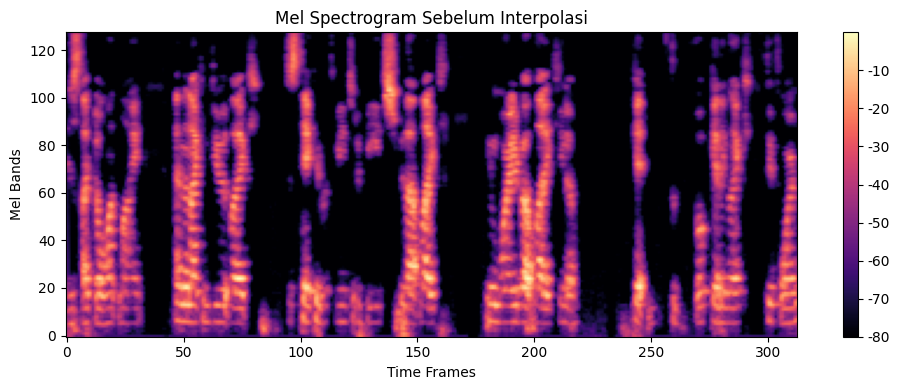

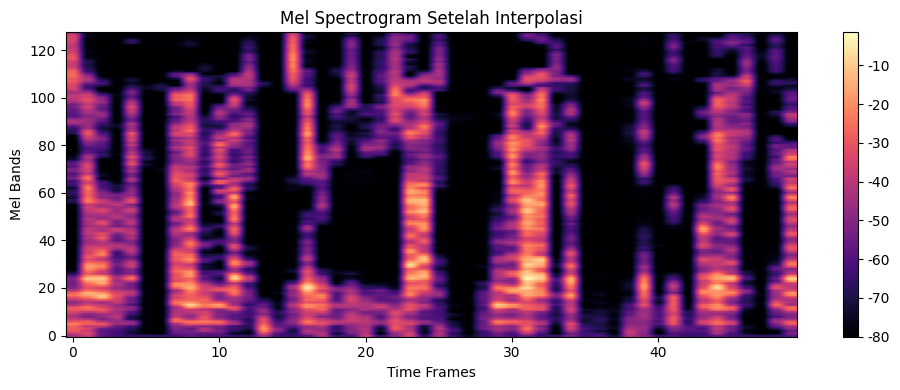

→ REAL (violations: 0)
barbcborgl.mp4 | GT: REAL | Pred: REAL


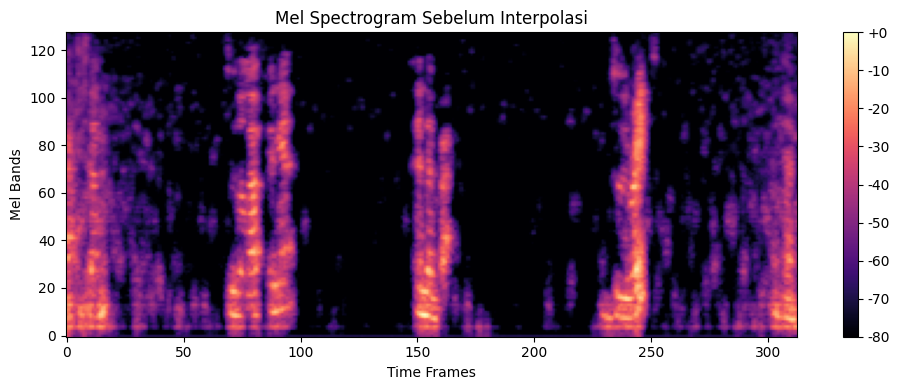

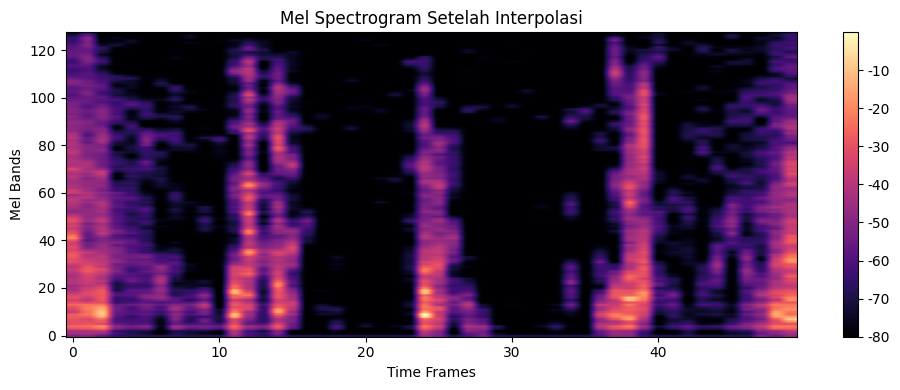

→ REAL (violations: 0)
barbcborgl_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL


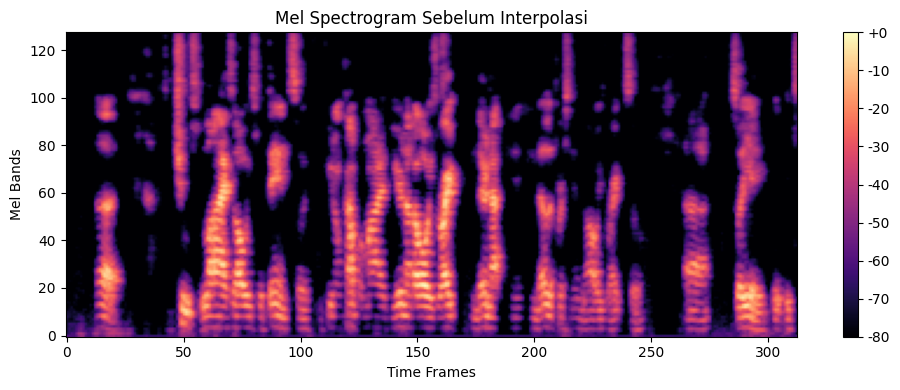

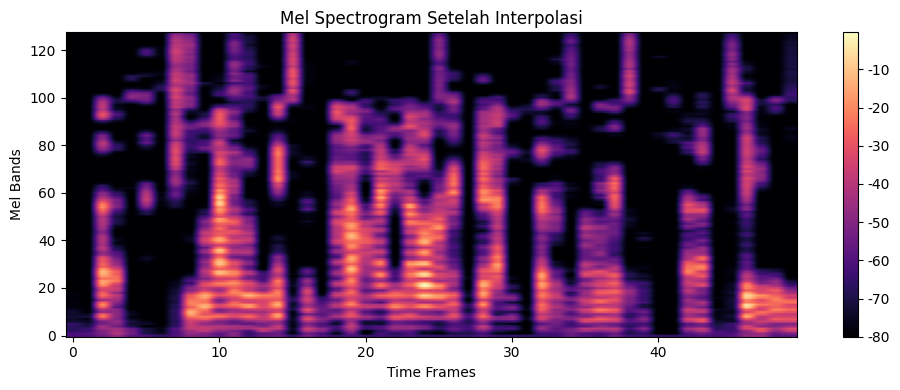

→ LIP-SYNC DEEPFAKE (violations: 4)
bfkzrgovsv.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


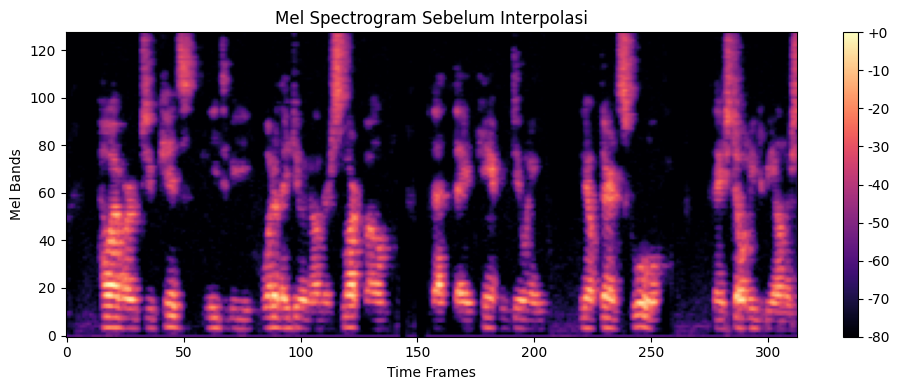

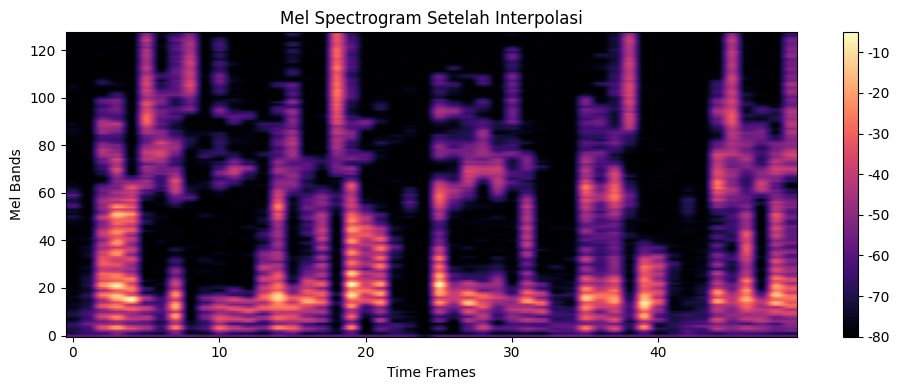

→ LIP-SYNC DEEPFAKE (violations: 2)
bfkzrgovsv_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] bfljjbavig.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


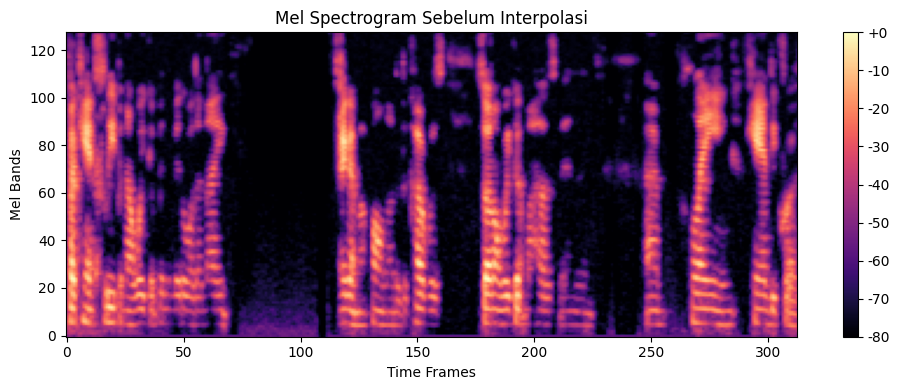

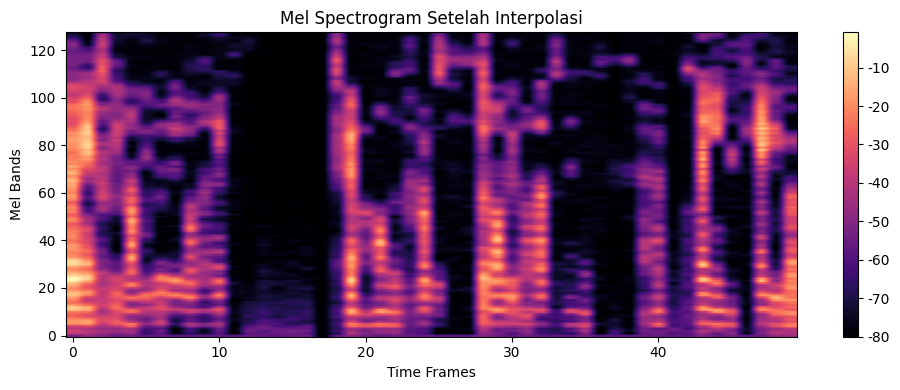

→ REAL (violations: 0)
bhqcqwcise.mp4 | GT: REAL | Pred: REAL


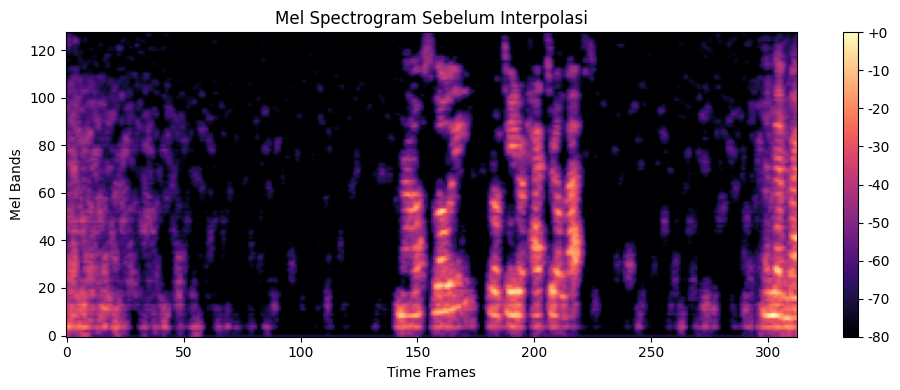

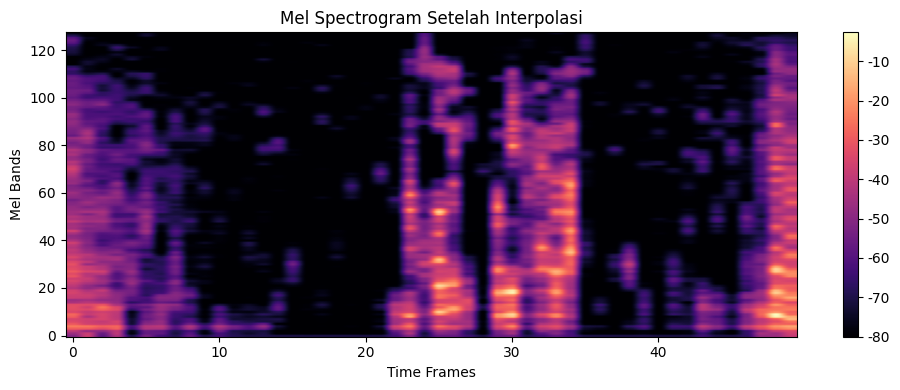

→ REAL (violations: 0)
bhqcqwcise_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] bqwwkjlmgv.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] Dataset/testing\chjatzdqcl.mp4: hanya 46 landmark < seharusnya 50
chjatzdqcl.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\chjatzdqcl_lipsync.mp4: hanya 45 landmark < seharusnya 50
chjatzdqcl_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED


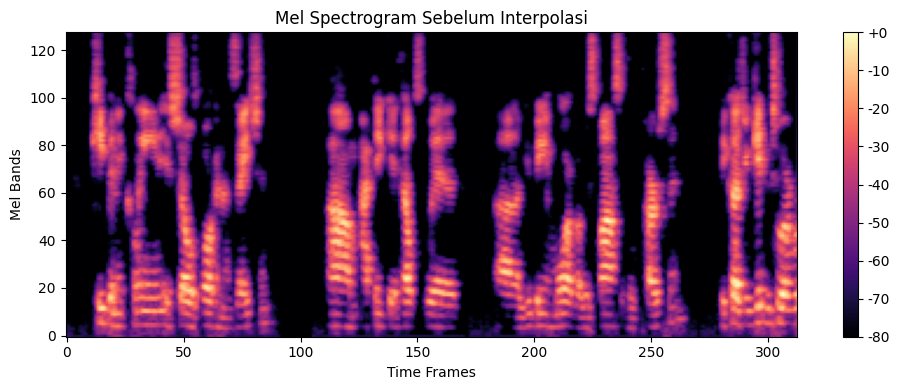

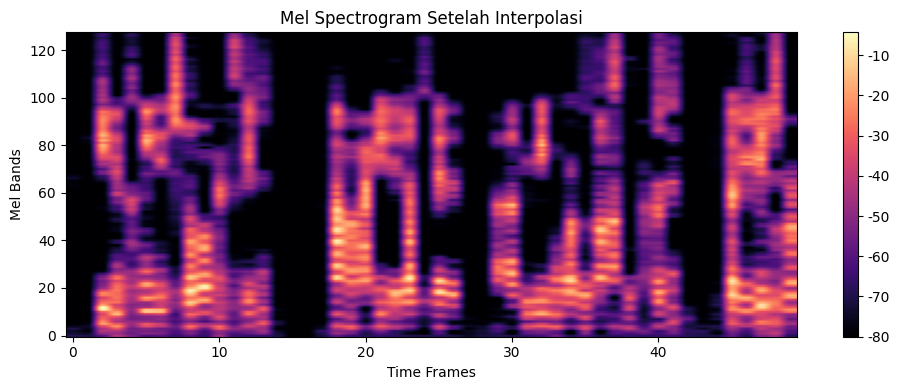

→ LIP-SYNC DEEPFAKE (violations: 3)
chnbexdyhq.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


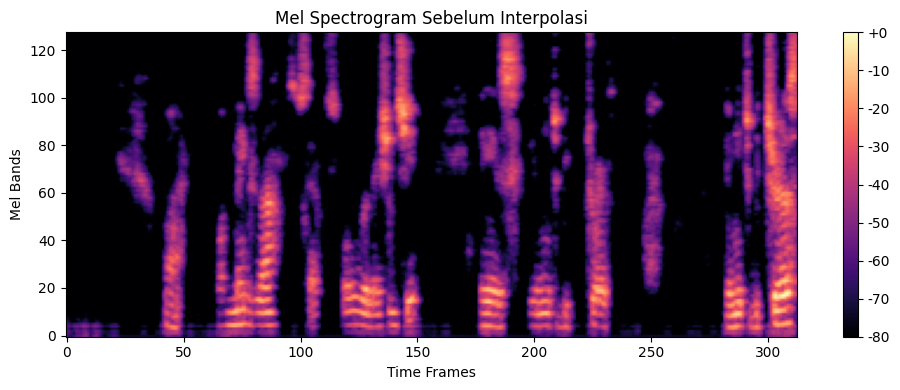

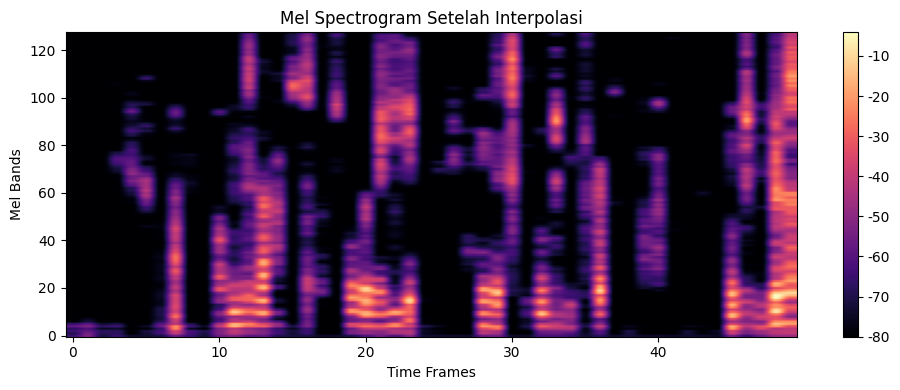

→ LIP-SYNC DEEPFAKE (violations: 2)
chnbexdyhq_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] cmbloezomc.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] cuewtjauyi.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] derkcaxbhk.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] dnirzrdpcv.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


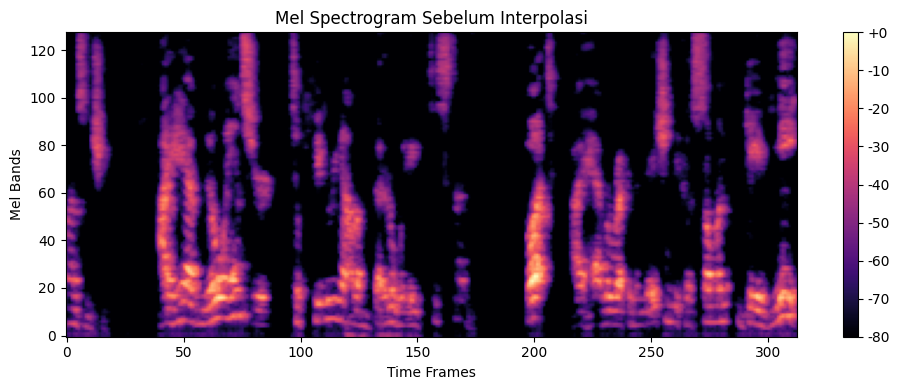

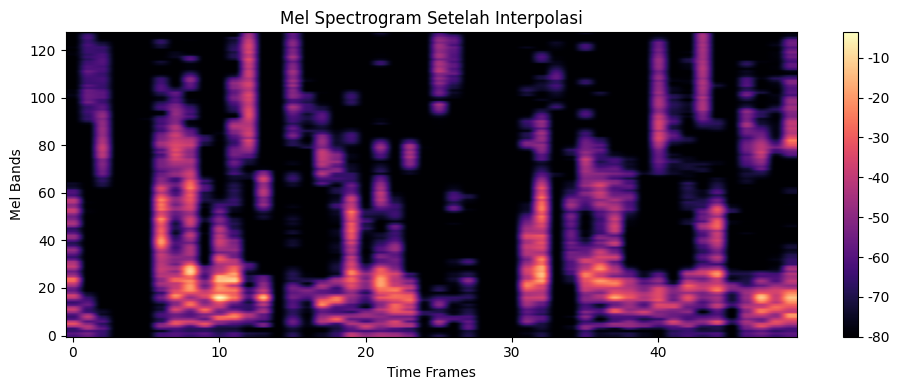

→ LIP-SYNC DEEPFAKE (violations: 3)
dopcoxsotn.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


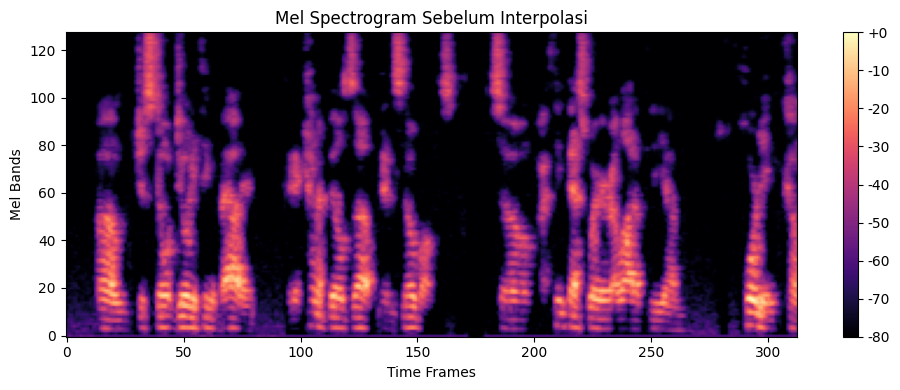

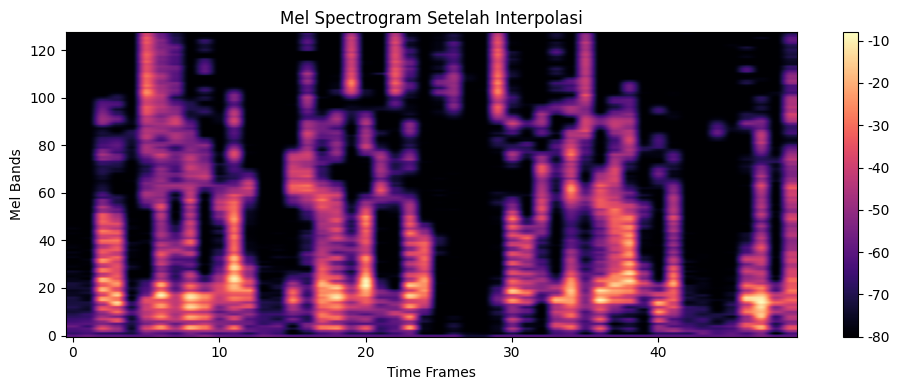

→ LIP-SYNC DEEPFAKE (violations: 3)
dopcoxsotn_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE


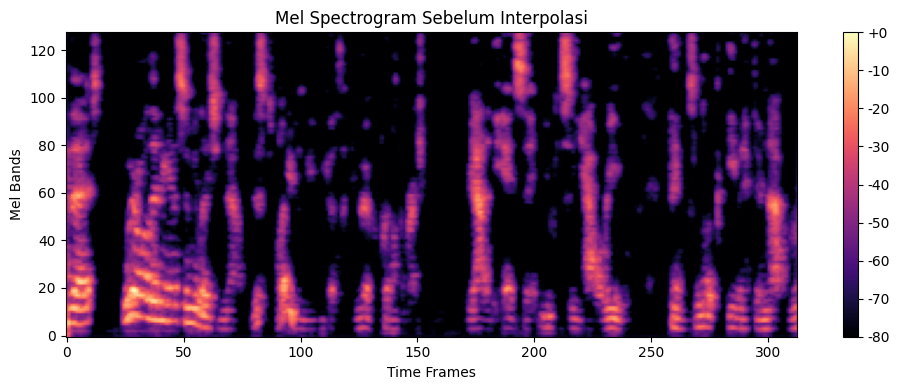

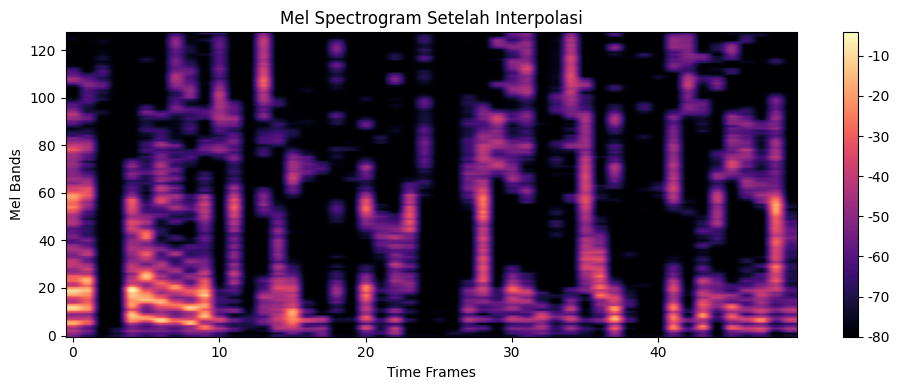

→ LIP-SYNC DEEPFAKE (violations: 3)
dpegbdzijf.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


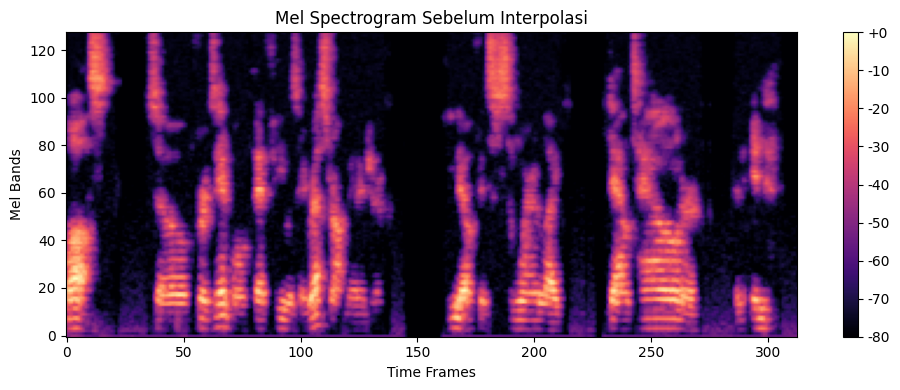

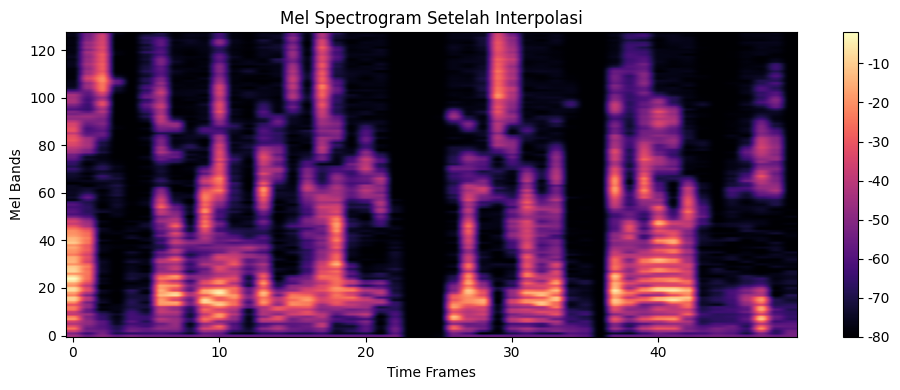

→ REAL (violations: 1)
dpegbdzijf_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL


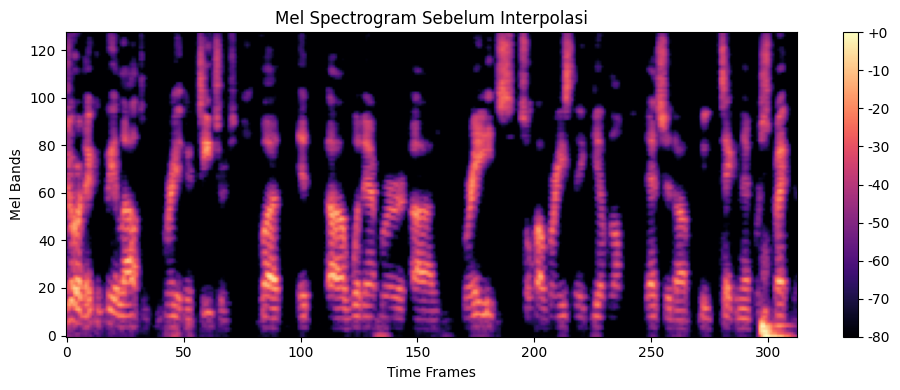

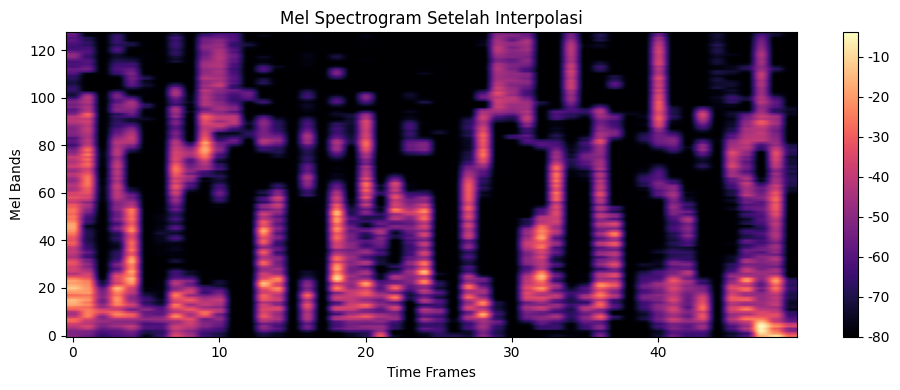

→ REAL (violations: 1)
dsveelyrgf.mp4 | GT: REAL | Pred: REAL
[SKIP] Dataset/testing\dsveelyrgf_lipsync.mp4: hanya 49 landmark < seharusnya 50
dsveelyrgf_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED
[SKIP] dvvglvssak.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] frame 0: belum ada wajah valid
[SKIP] Dataset/testing\dwmsebyypl.mp4: hanya 17 landmark < seharusnya 50
dwmsebyypl.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] frame 0: belum ada wajah valid
[SKIP] frame 6: belum ada wajah valid
[SKIP] frame 12: belum ada wajah valid
[SKIP] frame 18: belum ada wajah valid
[SKIP] frame 24: belum ada wajah valid
[SKIP] Dataset/testing\dwmsebyypl_lipsync.mp4: hanya 19 landmark < seharusnya 50
dwmsebyypl_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED


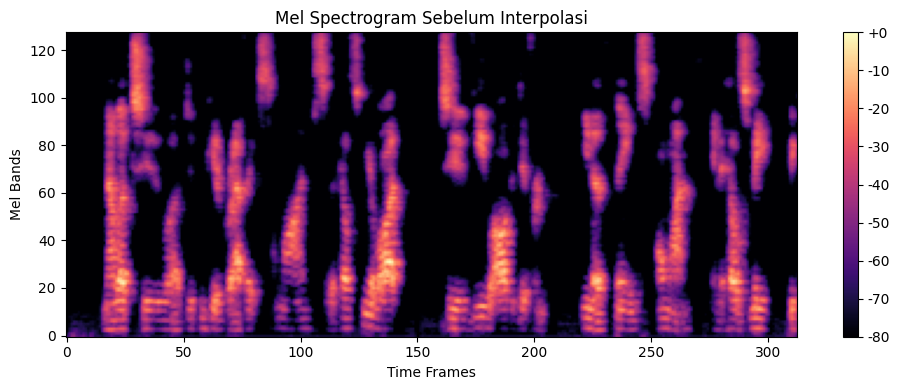

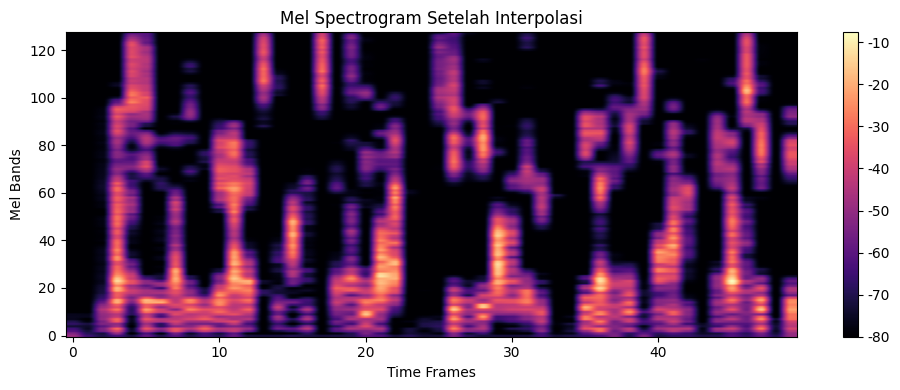

→ LIP-SYNC DEEPFAKE (violations: 2)
eaxkilqqgu.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


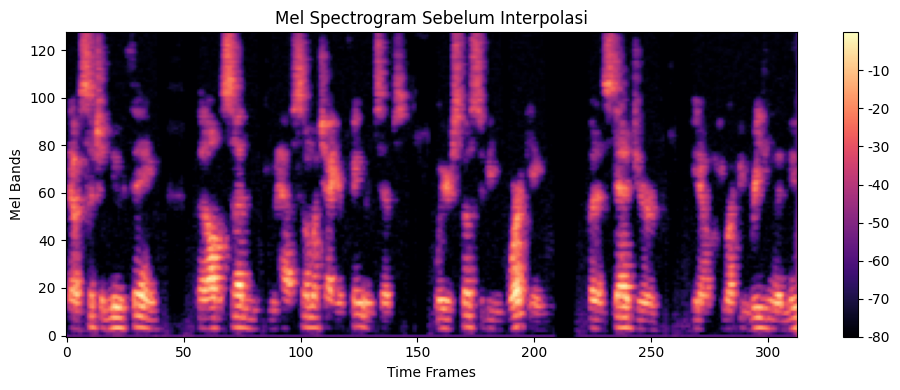

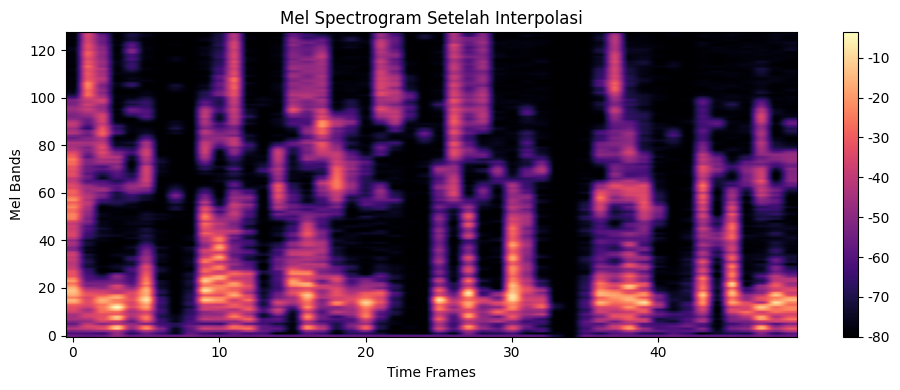

→ LIP-SYNC DEEPFAKE (violations: 3)
eaxkilqqgu_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] efqfomvqac.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] Dataset/testing\efstpwwzpb.mp4: hanya 48 landmark < seharusnya 50
efstpwwzpb.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\efstpwwzpb_lipsync.mp4: hanya 45 landmark < seharusnya 50
efstpwwzpb_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED


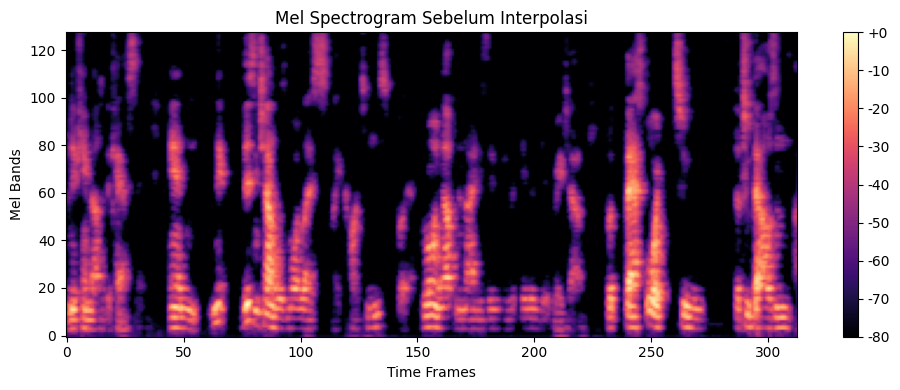

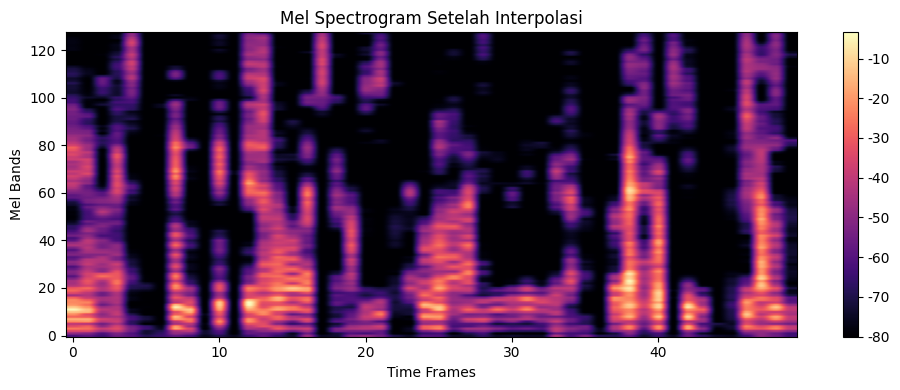

→ REAL (violations: 0)
emgciwmtuj.mp4 | GT: REAL | Pred: REAL


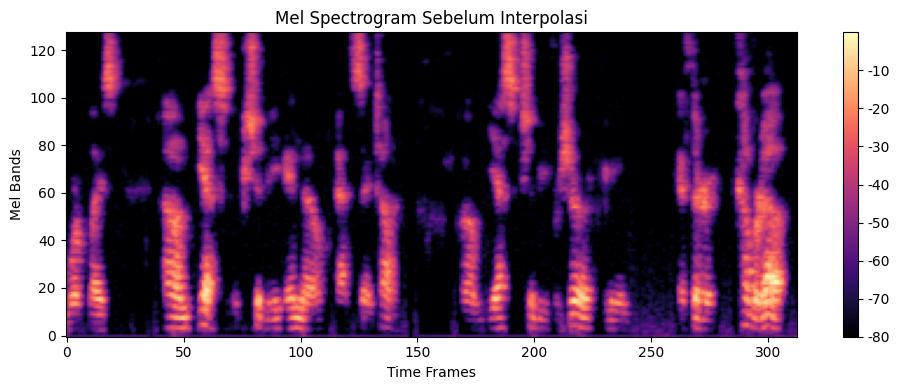

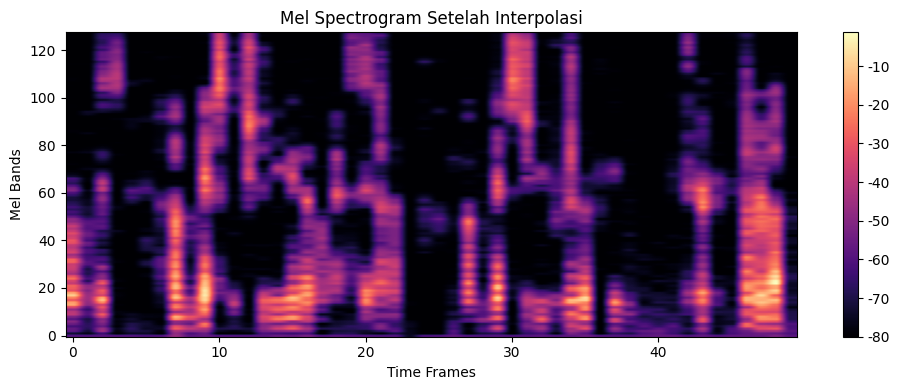

→ LIP-SYNC DEEPFAKE (violations: 3)
emgciwmtuj_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE


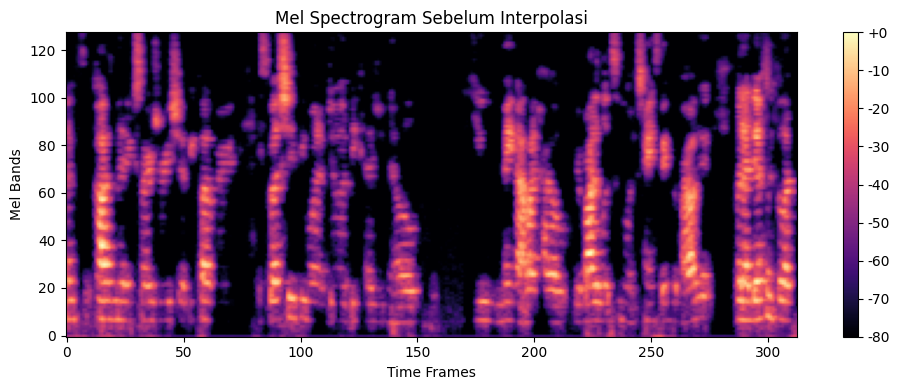

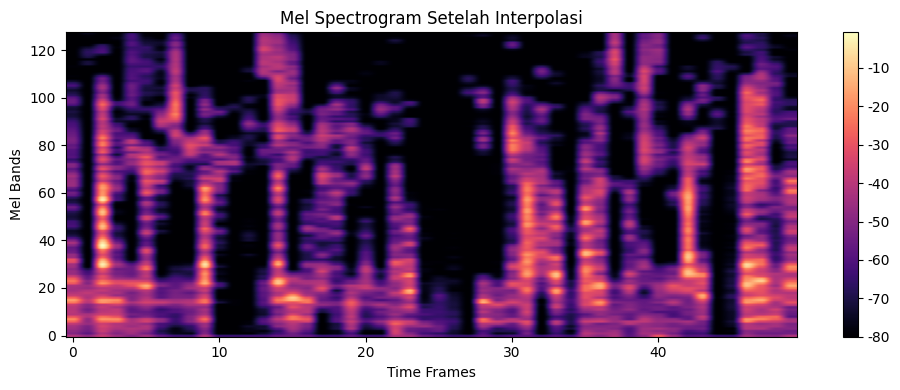

→ REAL (violations: 0)
encvnokybd.mp4 | GT: REAL | Pred: REAL


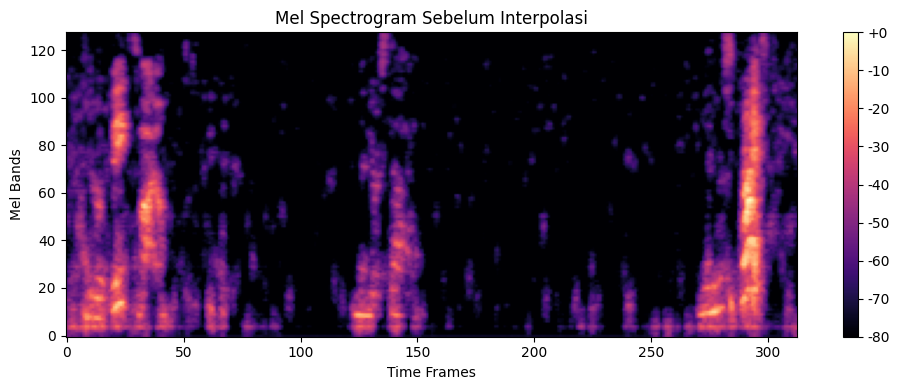

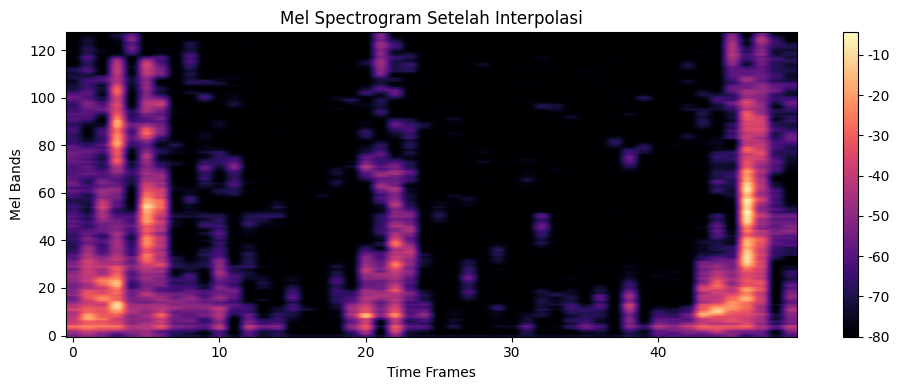

→ REAL (violations: 1)
encvnokybd_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] enhrmlgvnt.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] evyqbkbsiv.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


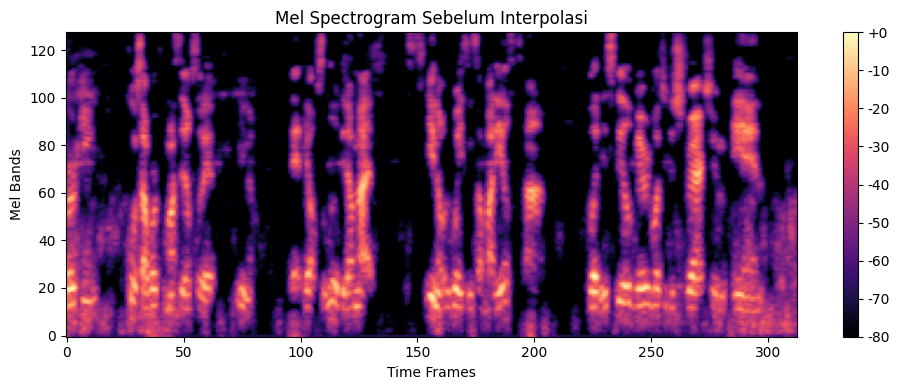

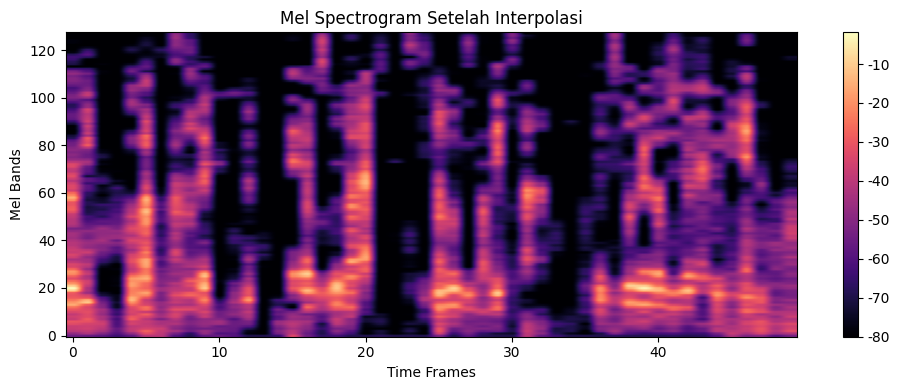

→ LIP-SYNC DEEPFAKE (violations: 2)
fafelguets.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


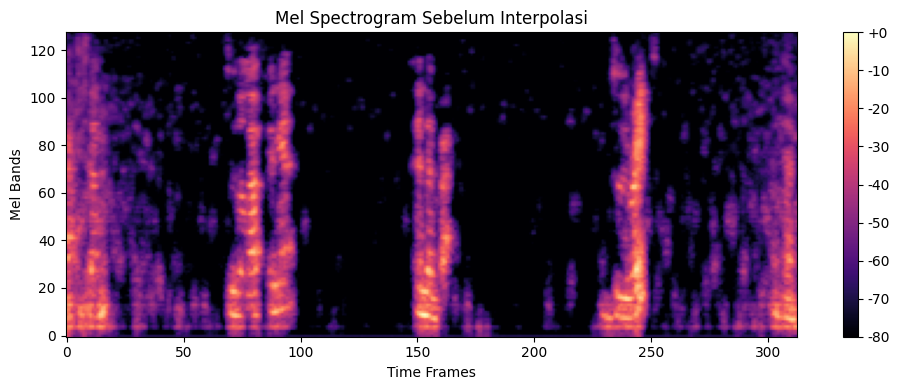

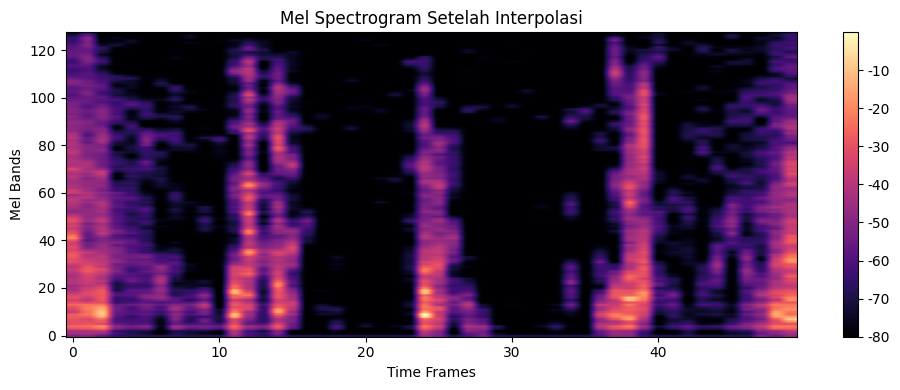

→ LIP-SYNC DEEPFAKE (violations: 2)
fafelguets_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] fgtpkjnclo.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] fpafdiehsl.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] gbambjdbwq.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] gilrccufxa.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


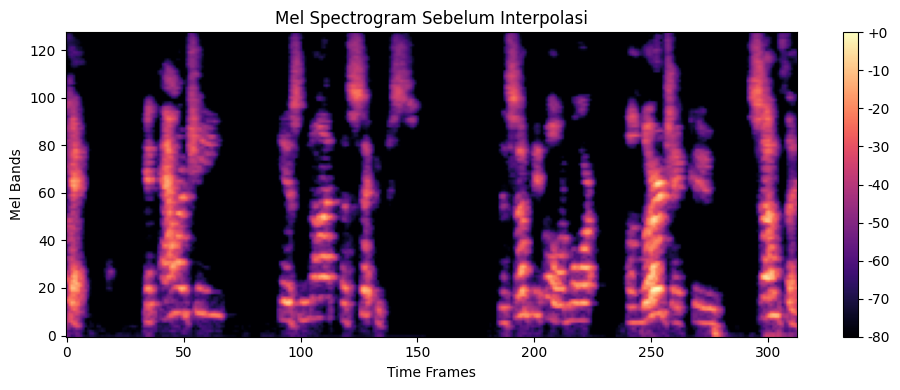

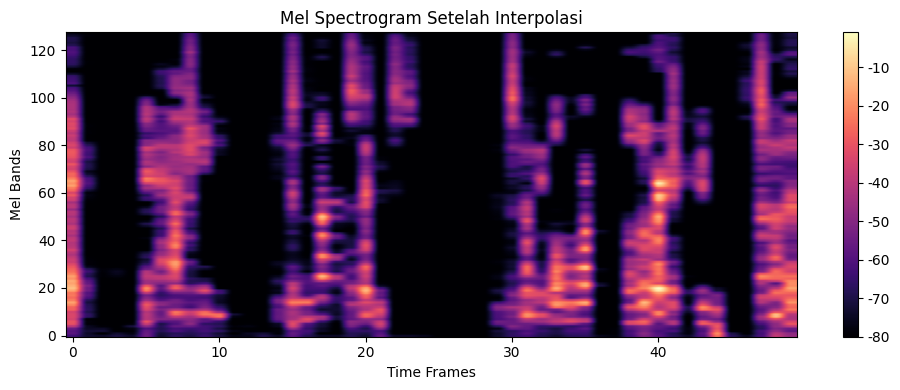

→ LIP-SYNC DEEPFAKE (violations: 2)
glxfafqbcf.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


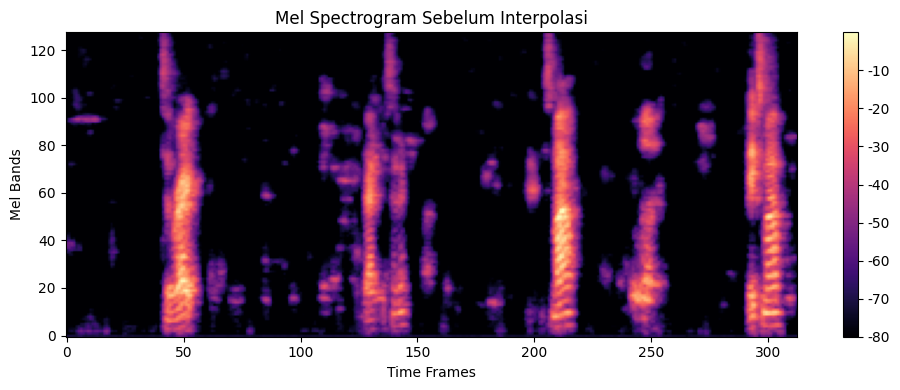

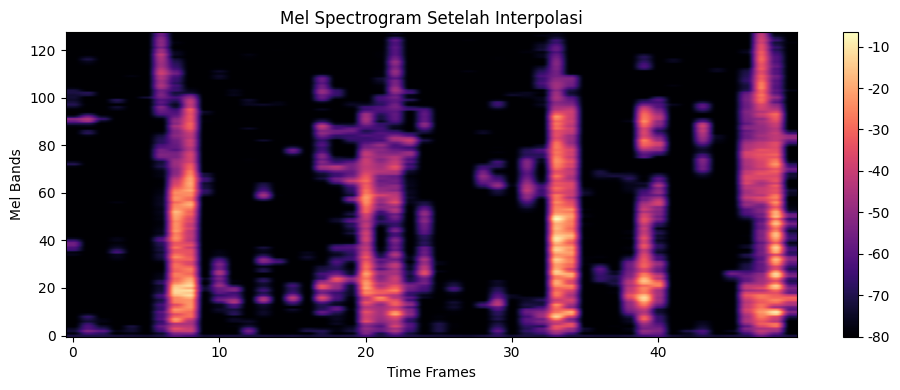

→ LIP-SYNC DEEPFAKE (violations: 3)
glxfafqbcf_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE


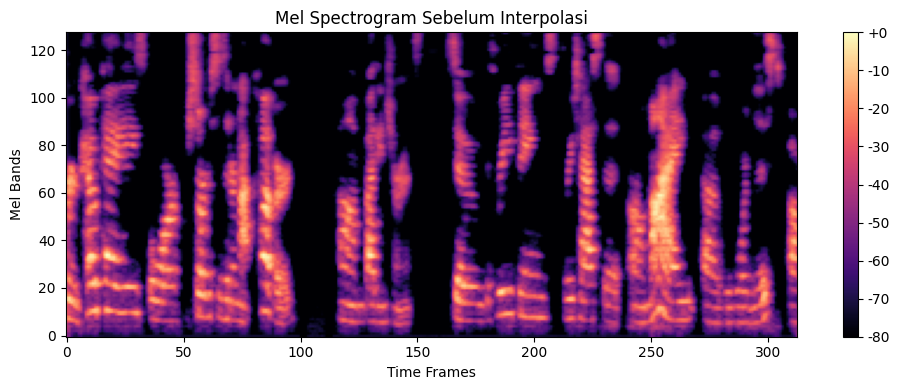

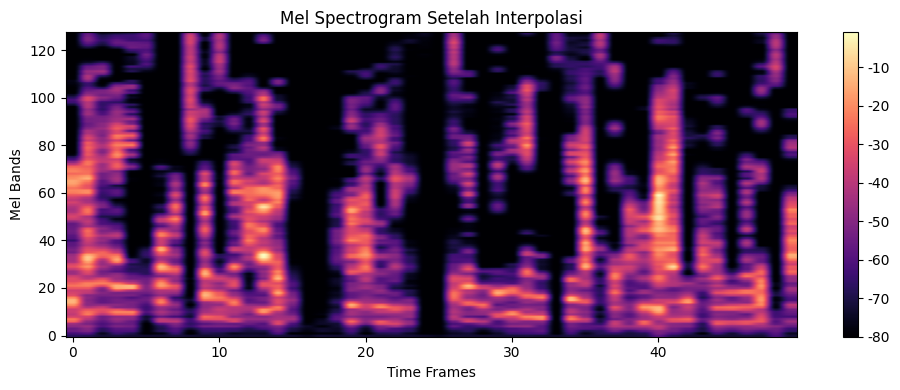

→ LIP-SYNC DEEPFAKE (violations: 3)
gnslcjmktc.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


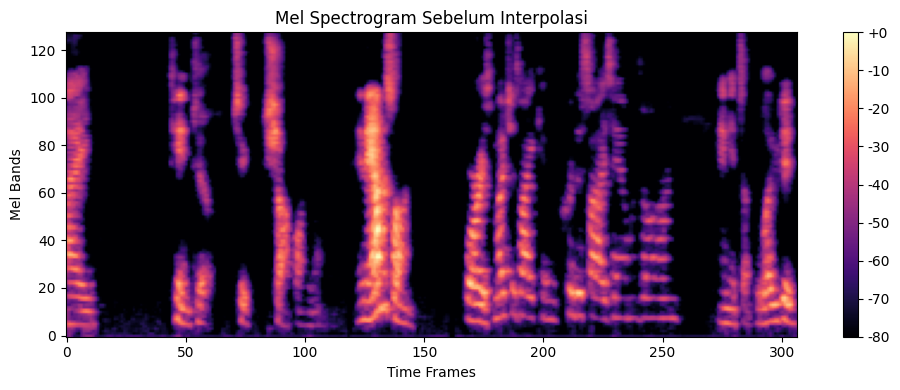

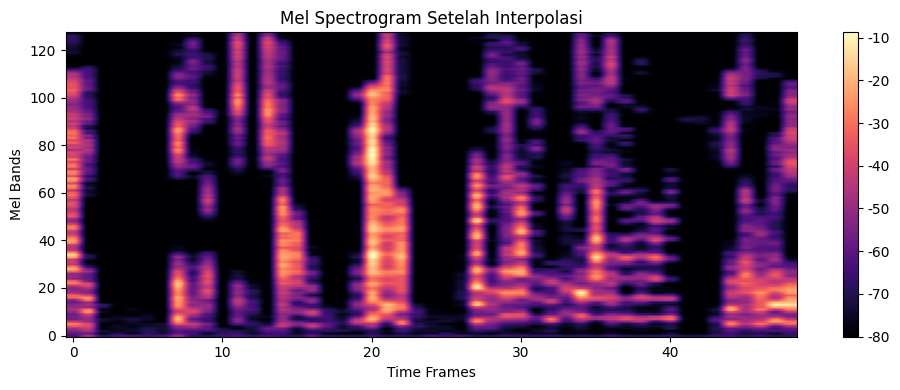

→ REAL (violations: 1)
gnslcjmktc_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] gvyvbdlfap.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


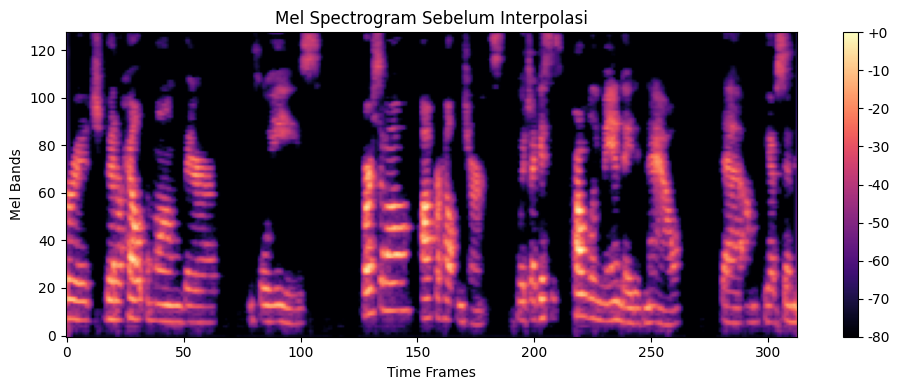

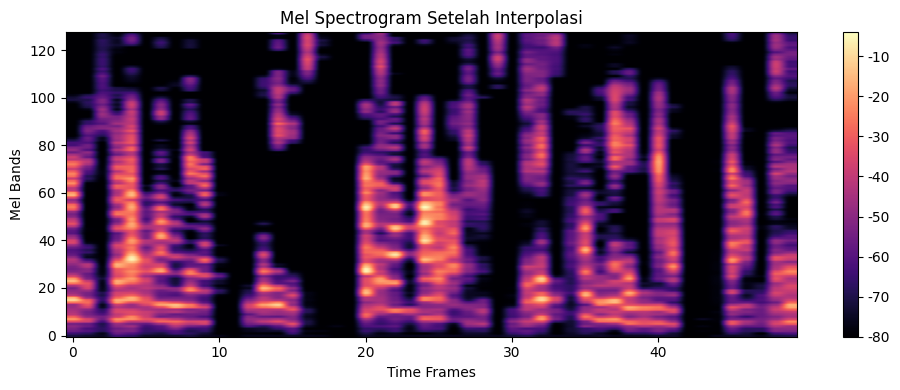

→ REAL (violations: 1)
hazcvdjzyf.mp4 | GT: REAL | Pred: REAL


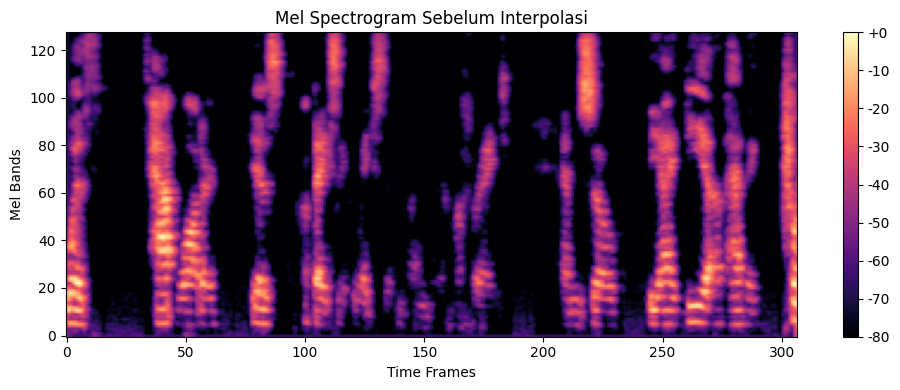

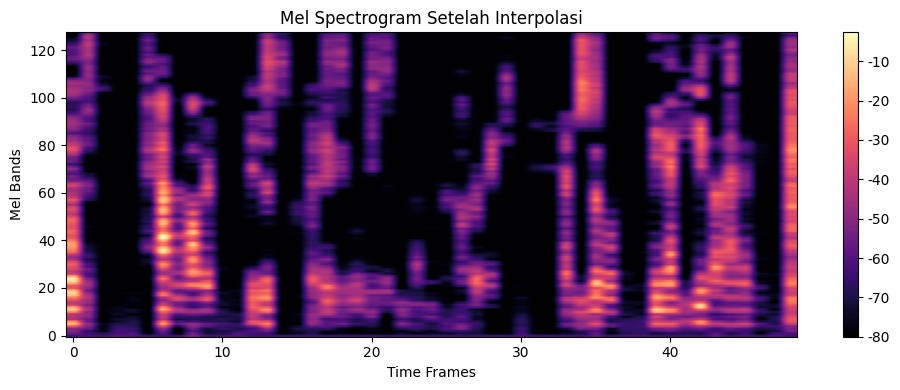

→ LIP-SYNC DEEPFAKE (violations: 2)
hazcvdjzyf_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] hfspenqmpw.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


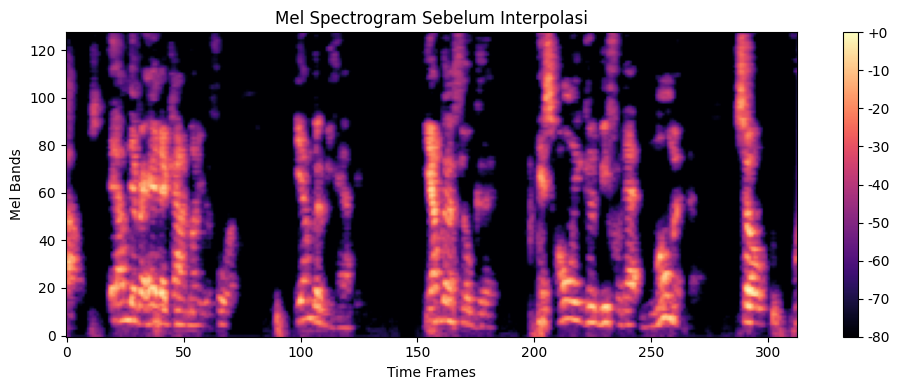

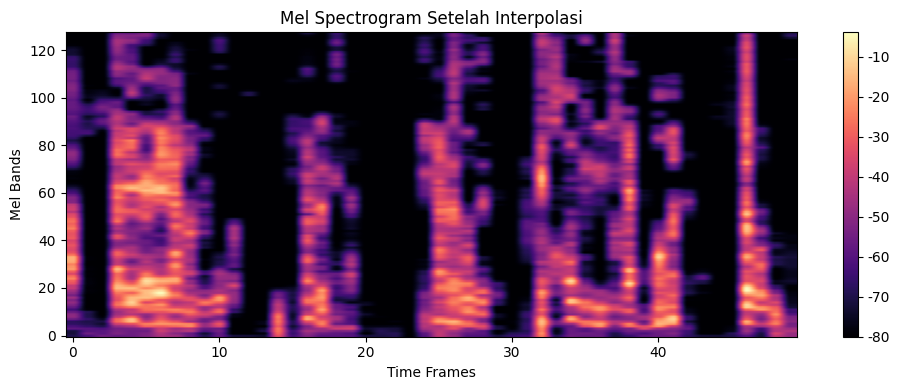

→ LIP-SYNC DEEPFAKE (violations: 2)
hjlzopctcs.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


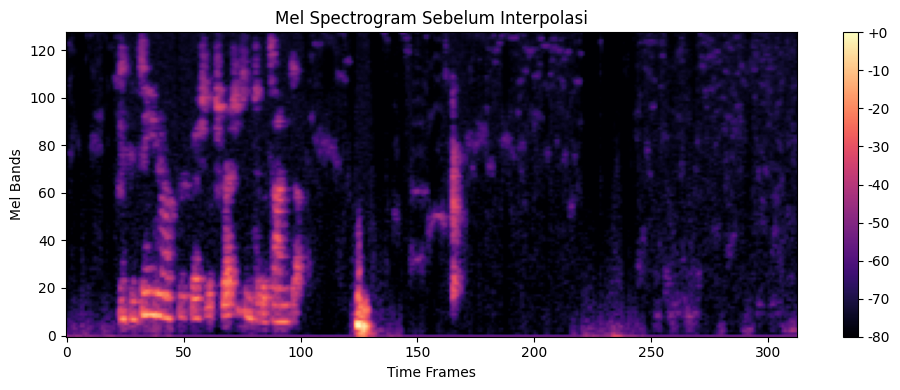

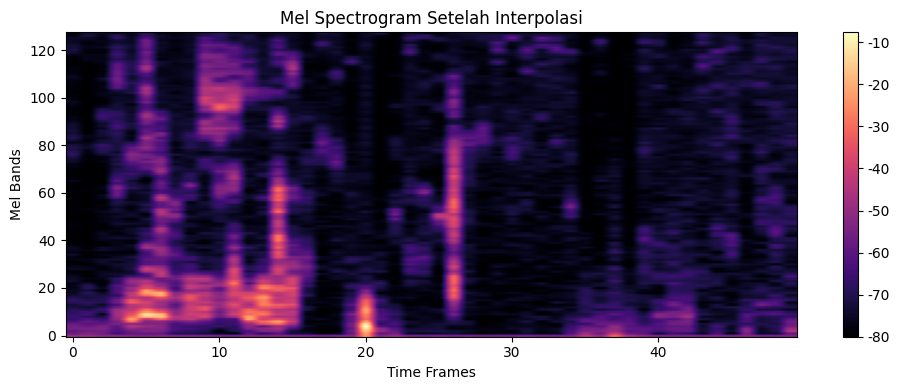

→ LIP-SYNC DEEPFAKE (violations: 3)
hjlzopctcs_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE


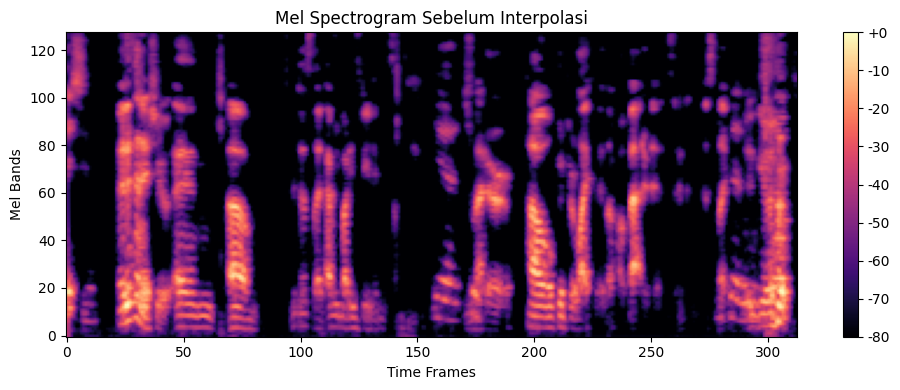

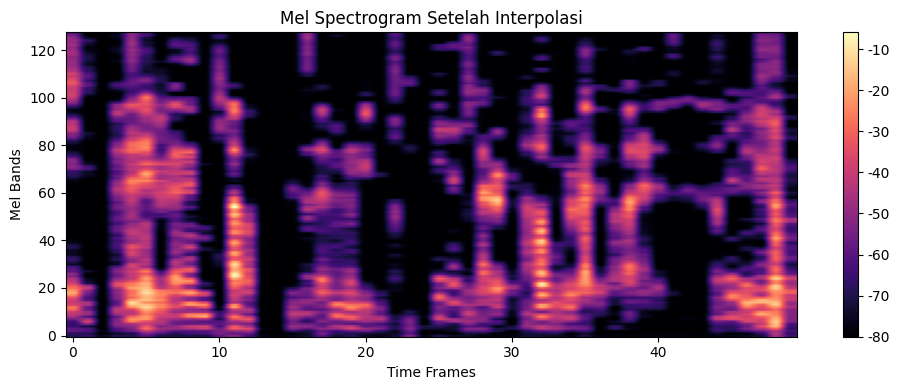

→ REAL (violations: 1)
idklchvhxp.mp4 | GT: REAL | Pred: REAL


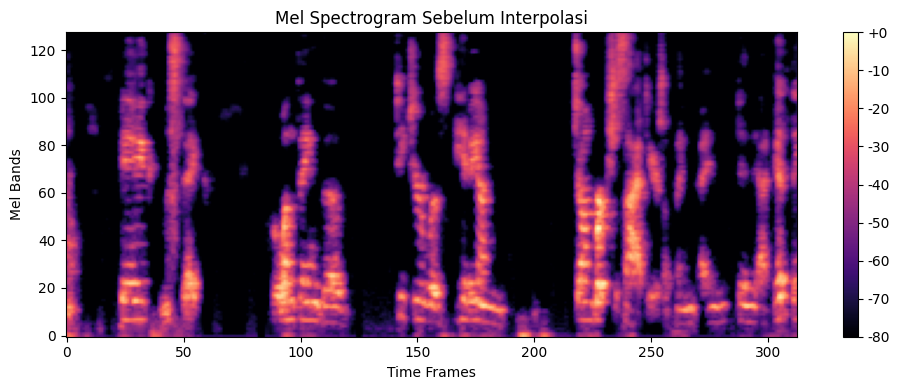

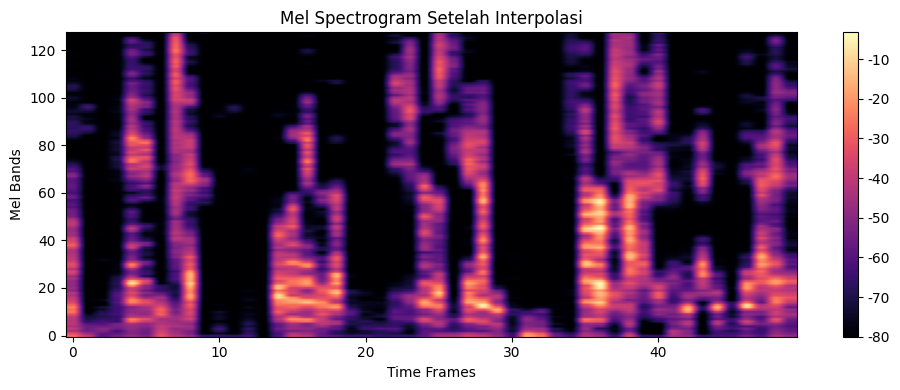

→ REAL (violations: 1)
idklchvhxp_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] ihbkkxqfue.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] ijvicicjwi.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] jbysofevrm.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] Dataset/testing\jygbqsigcr.mp4: hanya 49 landmark < seharusnya 50
jygbqsigcr.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\jygbqsigcr_lipsync.mp4: hanya 48 landmark < seharusnya 50
jygbqsigcr_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED


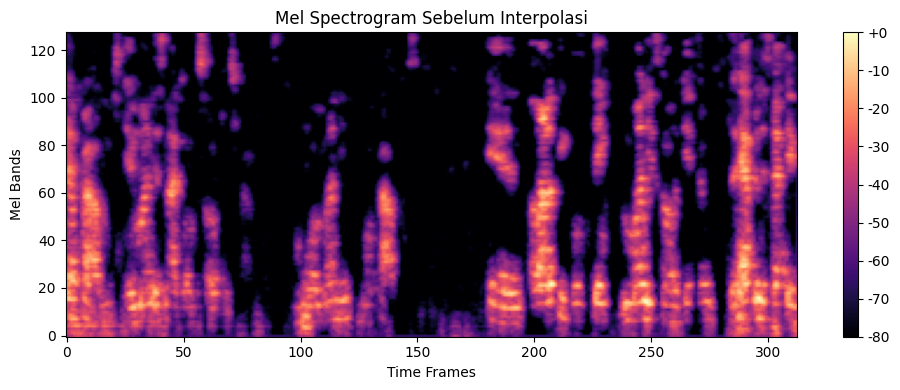

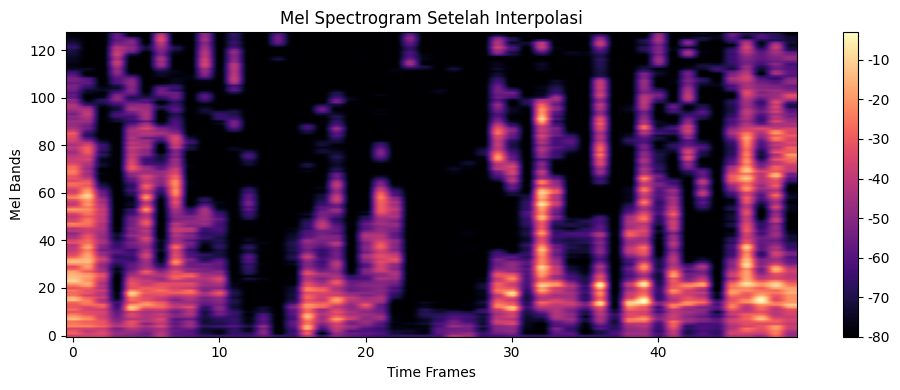

→ REAL (violations: 0)
kclflittyf.mp4 | GT: REAL | Pred: REAL


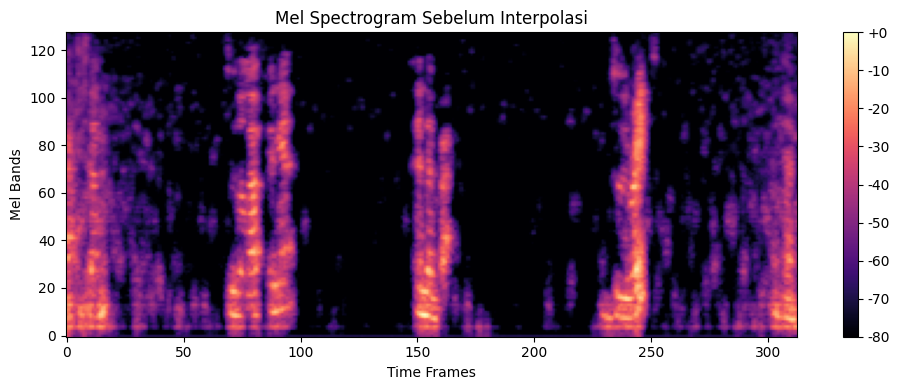

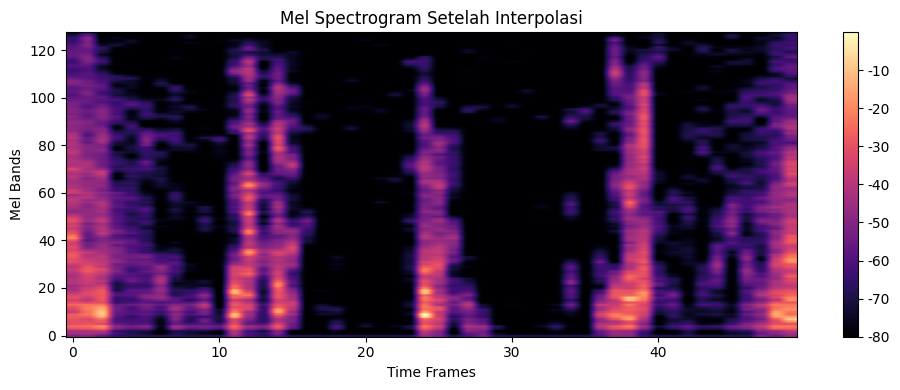

→ REAL (violations: 1)
kclflittyf_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] Dataset/testing\kdnwqamydh.mp4: hanya 40 landmark < seharusnya 50
kdnwqamydh.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\kdnwqamydh_lipsync.mp4: hanya 40 landmark < seharusnya 50
kdnwqamydh_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED
[SKIP] kqamviihso.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


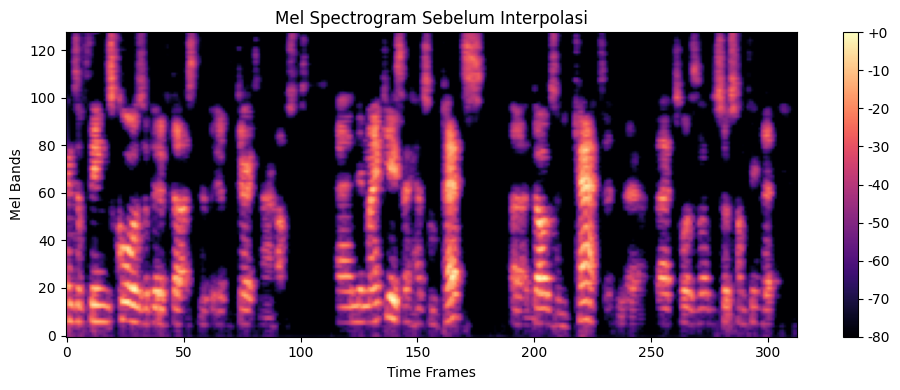

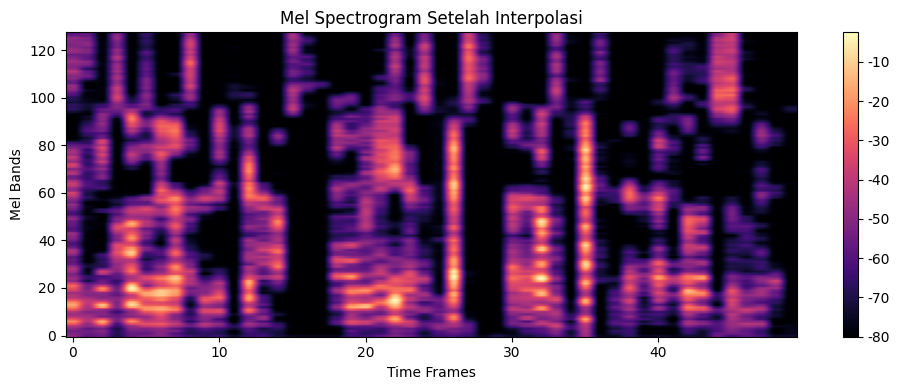

→ LIP-SYNC DEEPFAKE (violations: 3)
ksyvrepnua.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


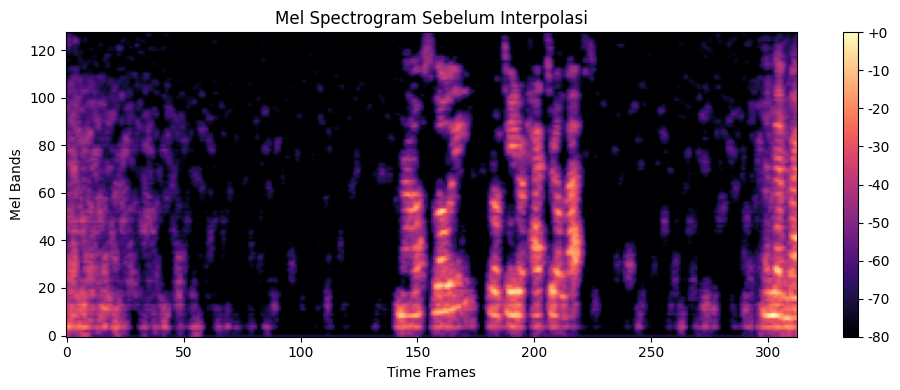

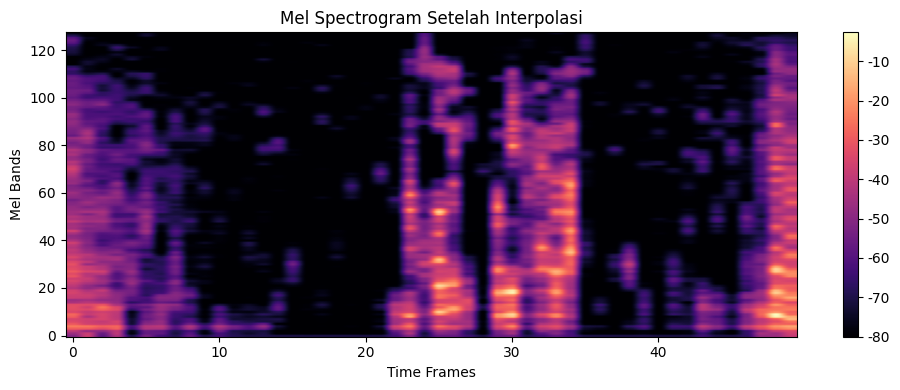

→ REAL (violations: 1)
ksyvrepnua_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] kuyowgtvvy.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] lgzclplvnt.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


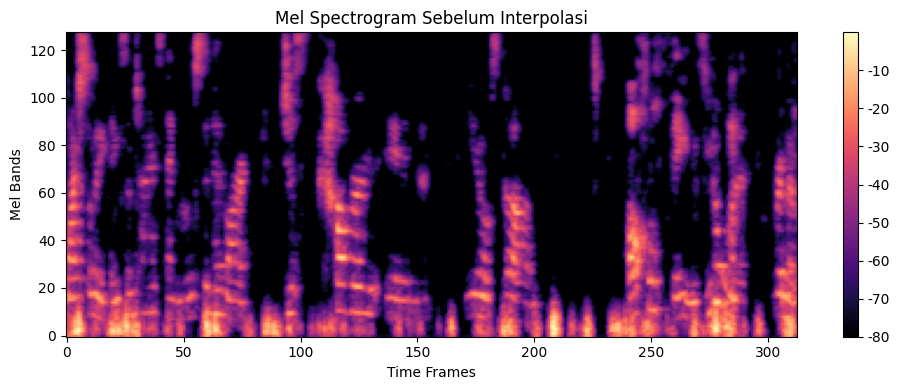

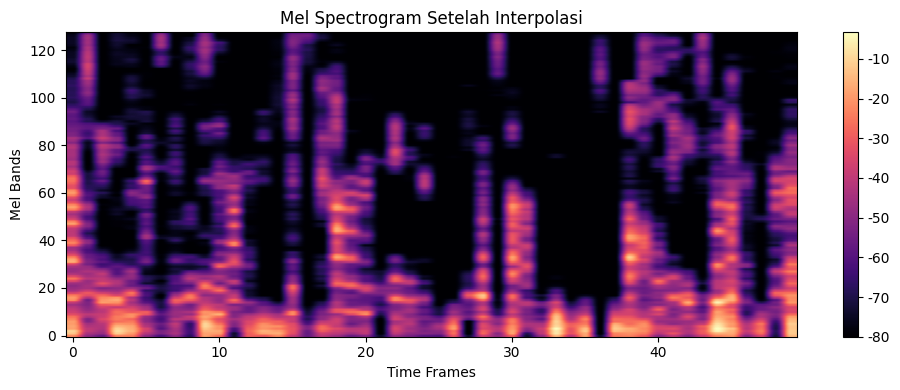

→ REAL (violations: 1)
mlizcisxro.mp4 | GT: REAL | Pred: REAL


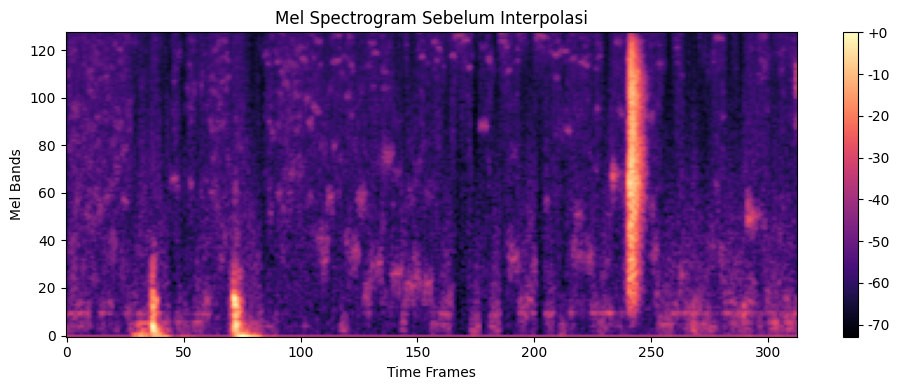

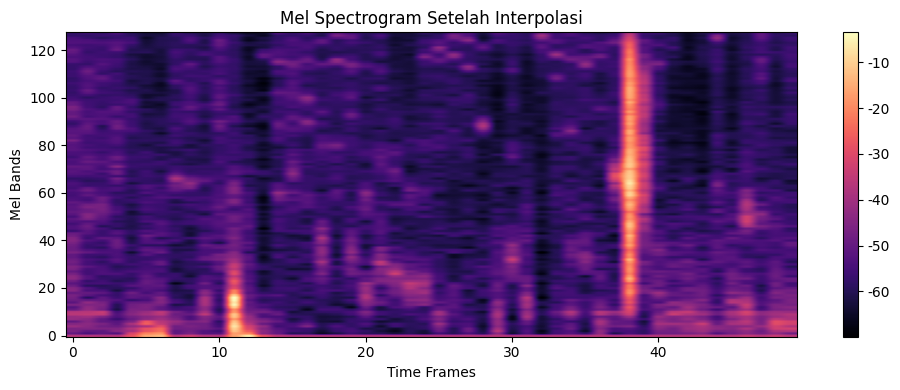

→ LIP-SYNC DEEPFAKE (violations: 3)
mlizcisxro_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE


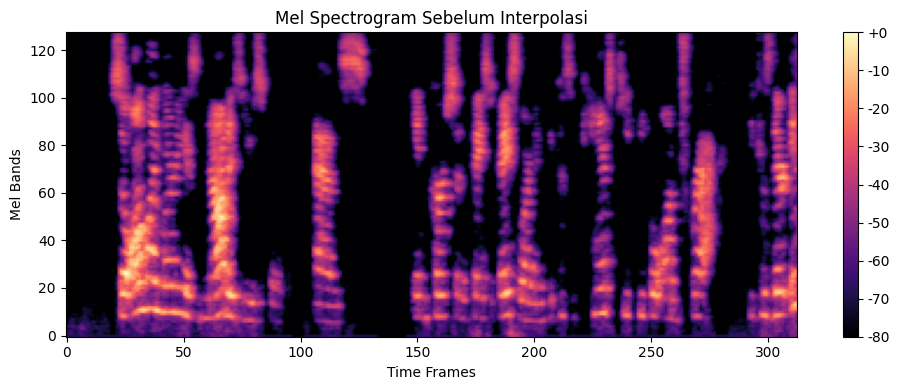

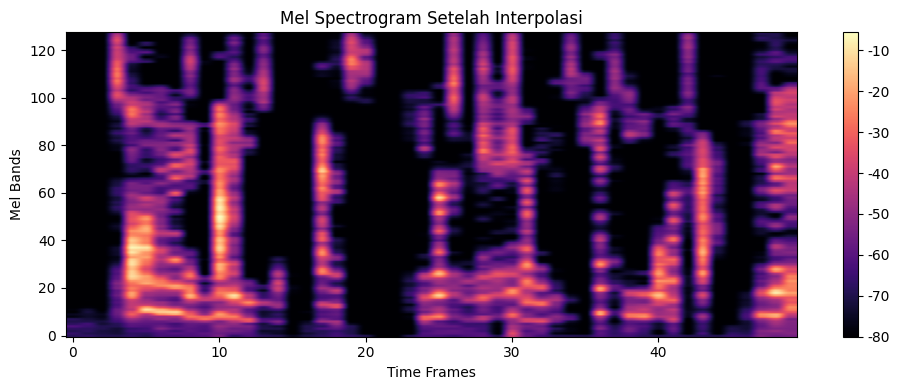

→ LIP-SYNC DEEPFAKE (violations: 2)
mnlxxoicoo.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


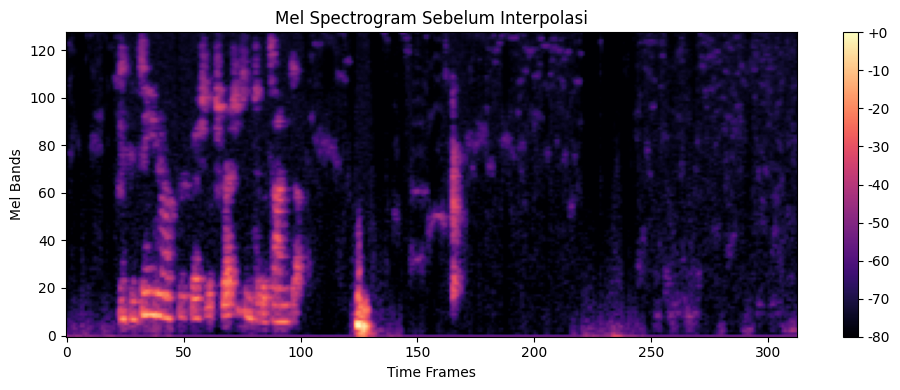

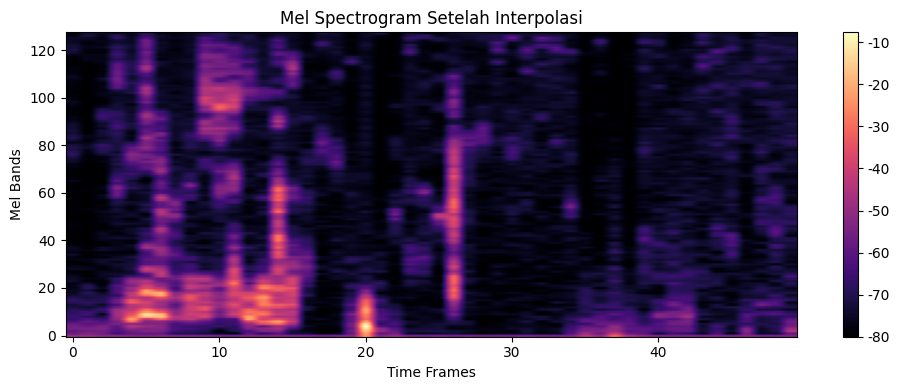

→ REAL (violations: 1)
mnlxxoicoo_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] Dataset/testing\mthkmtbuab.mp4: hanya 48 landmark < seharusnya 50
mthkmtbuab.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\mthkmtbuab_lipsync.mp4: hanya 49 landmark < seharusnya 50
mthkmtbuab_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED
[SKIP] mvfvefsgik.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] mvfyexeghq.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] nnamqkfxas.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] ohmkmcfxul.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] omofkgvjyn.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] frame 0: belum ada wajah valid
[SKIP] Dataset/testing\ooavdkhcnf.mp4: hanya 28 landmark < seharusnya 50
ooavdkhcnf.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] frame 0: belum ada wajah valid
[SKIP] Dataset/testing\ooavdkhcnf_lipsync.mp4: hanya 25 landmark < seharusnya 50
ooavdkhcnf_lipsync.mp4 | G

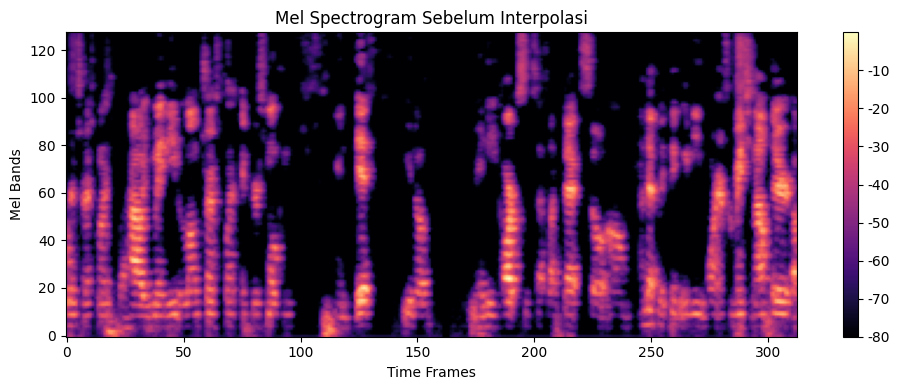

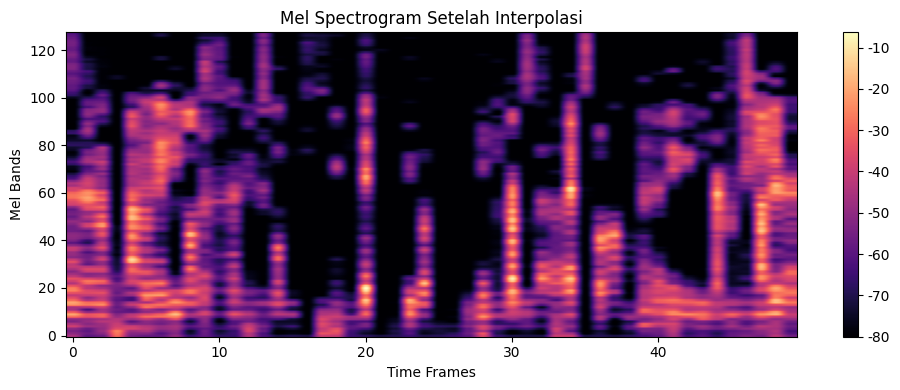

→ LIP-SYNC DEEPFAKE (violations: 4)
peqrlhqeuk.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


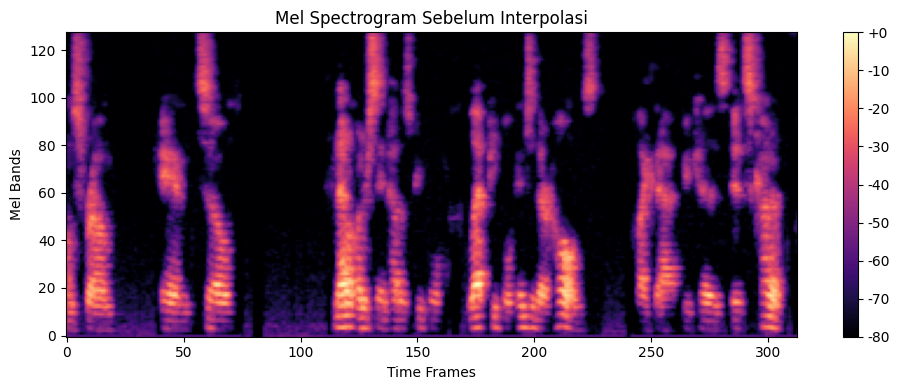

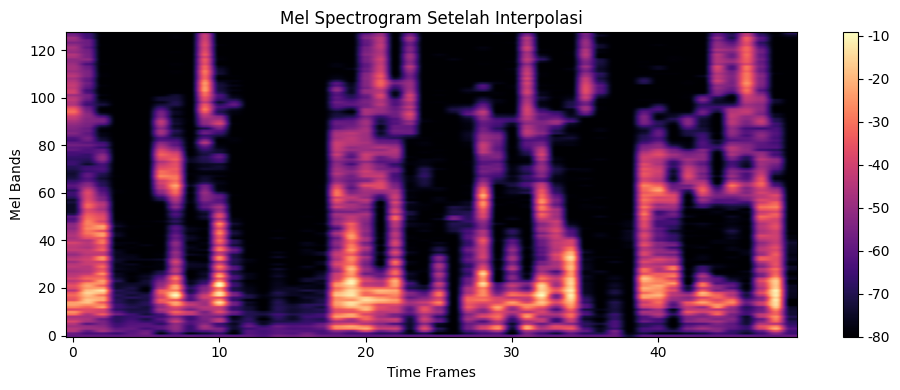

→ REAL (violations: 1)
peqrlhqeuk_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL


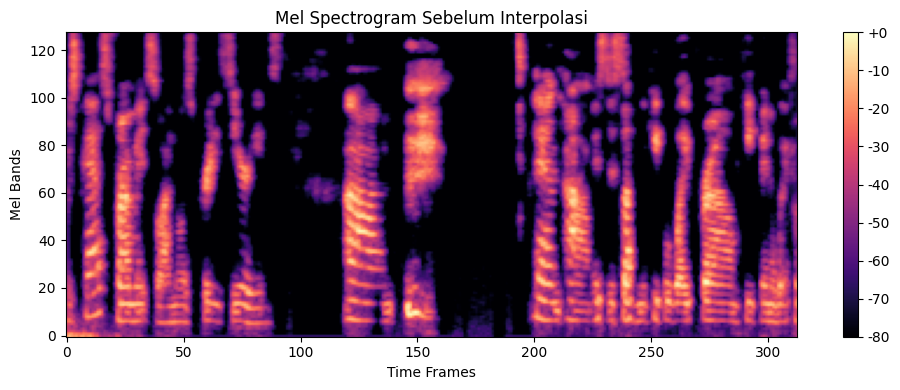

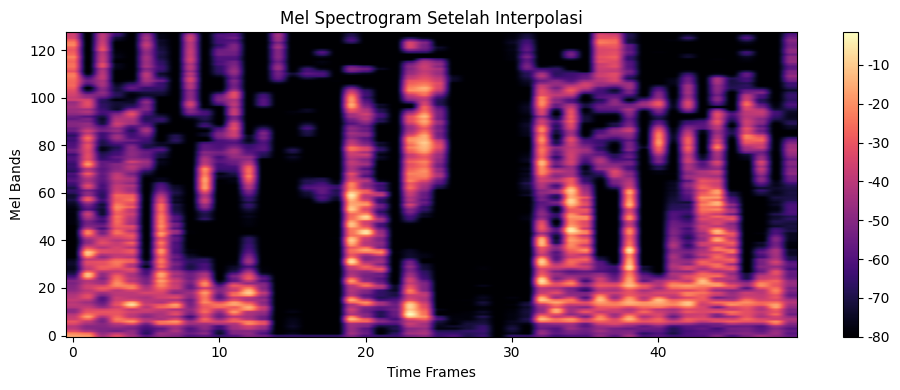

→ LIP-SYNC DEEPFAKE (violations: 4)
pkpxhevjjz.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


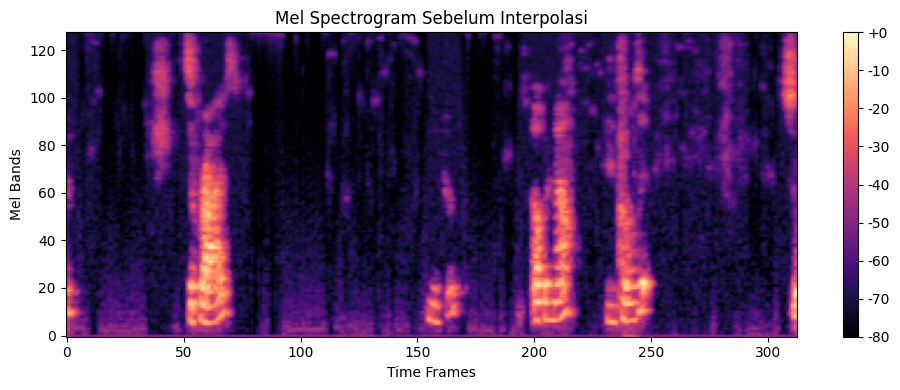

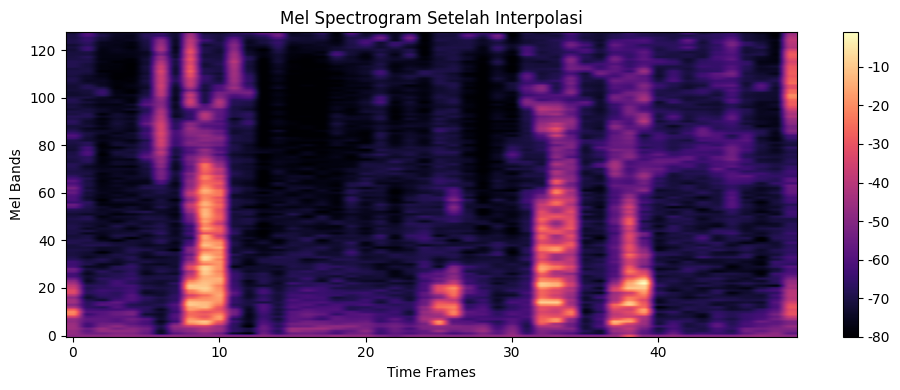

→ LIP-SYNC DEEPFAKE (violations: 3)
pkpxhevjjz_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] prruktoyam.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] pupjadwkax.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] puyyqevntm.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] pwyouvrckw.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


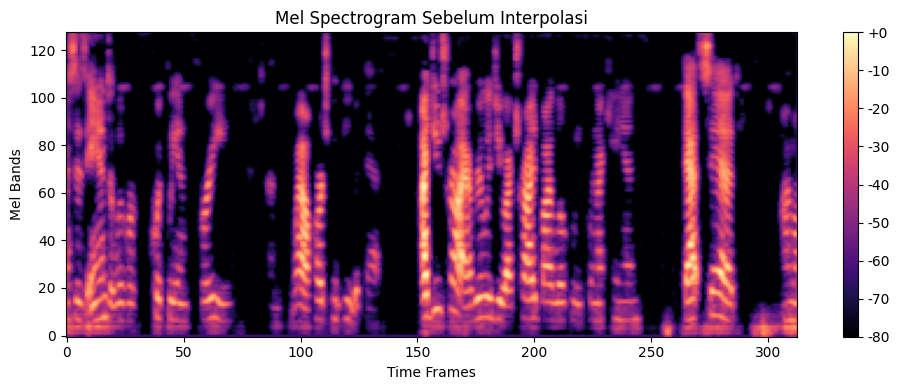

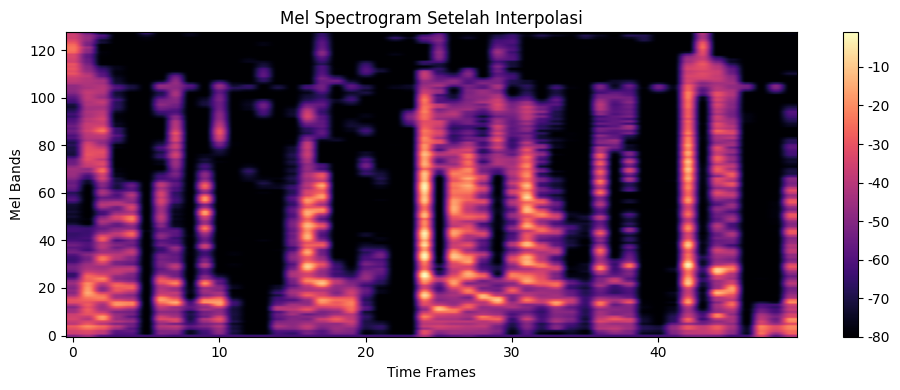

→ REAL (violations: 1)
qdbiwougrn.mp4 | GT: REAL | Pred: REAL


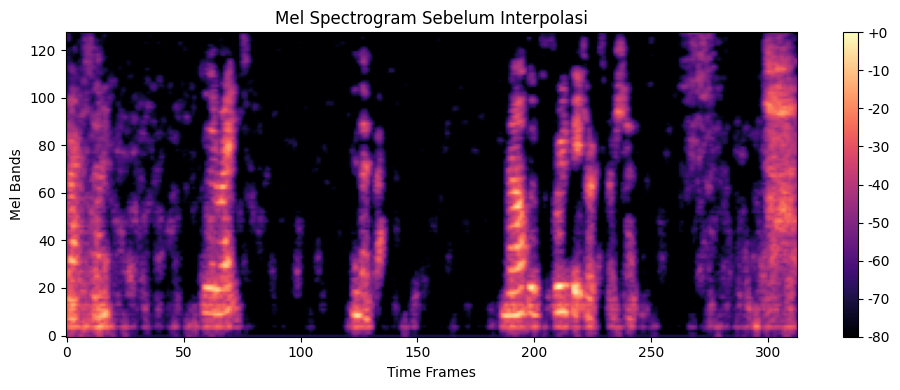

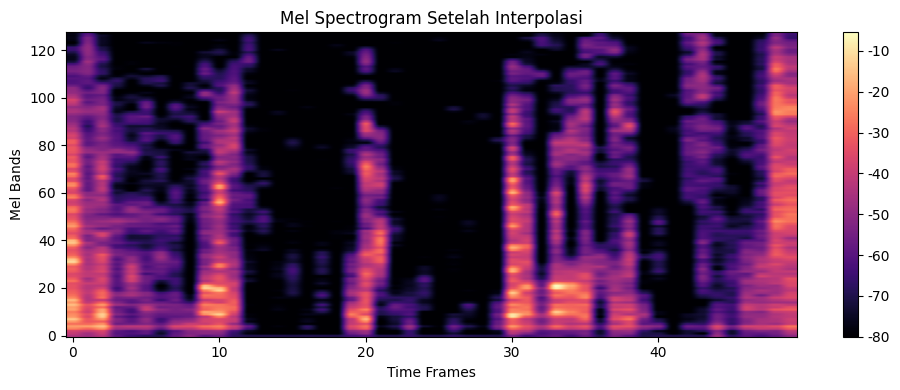

→ REAL (violations: 1)
qdbiwougrn_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] qhmpvfydoy.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


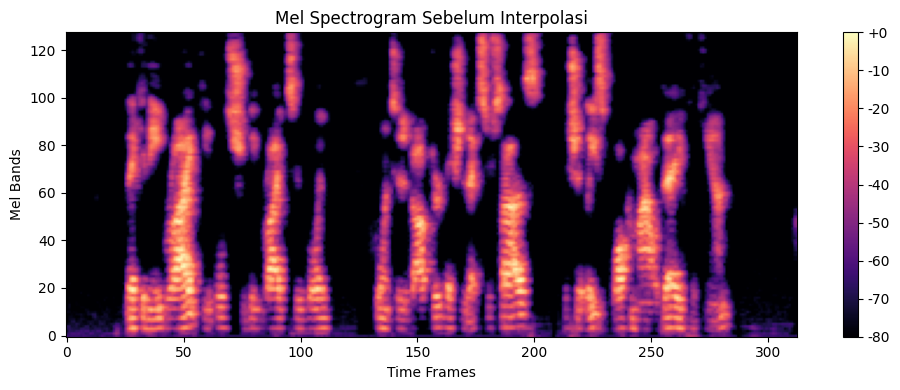

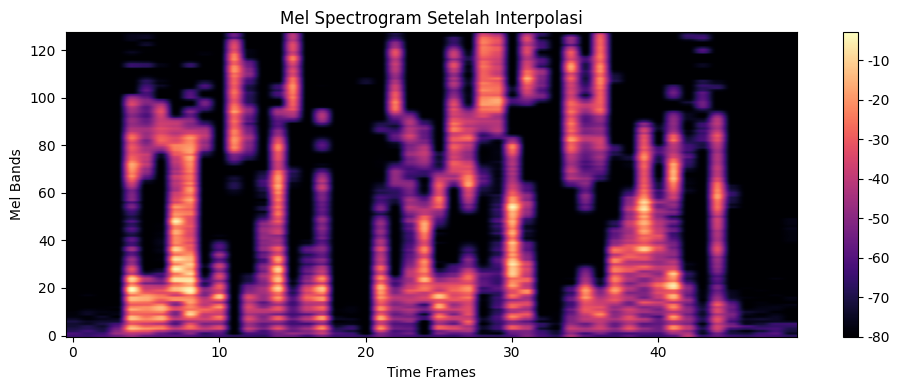

→ LIP-SYNC DEEPFAKE (violations: 2)
qpmepdhqlv.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


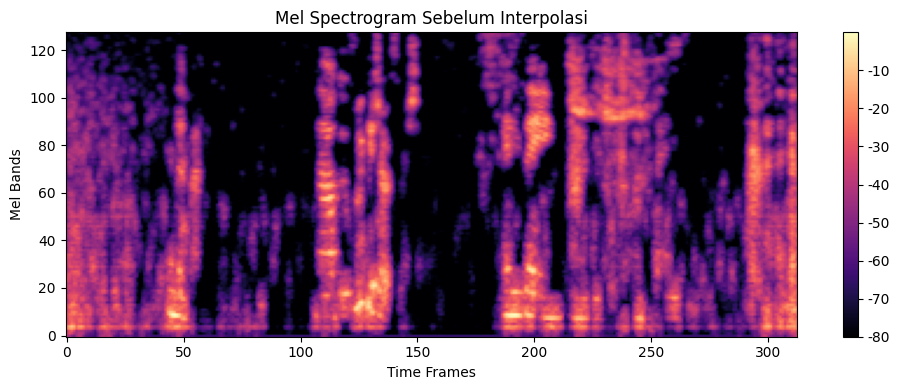

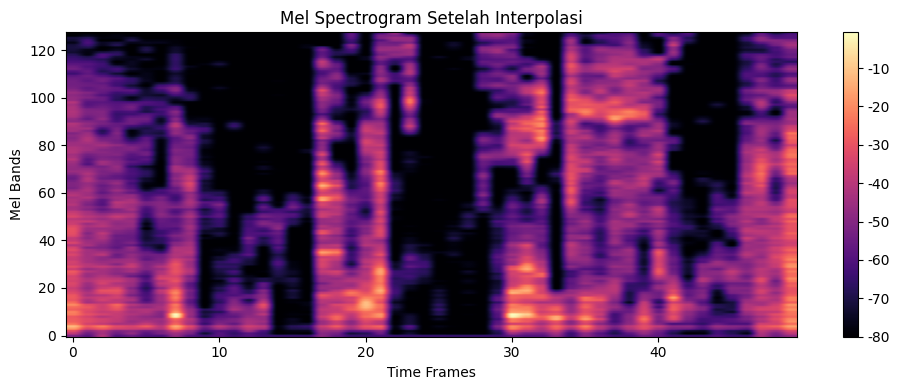

→ LIP-SYNC DEEPFAKE (violations: 2)
qpmepdhqlv_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] rlffjyqing.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


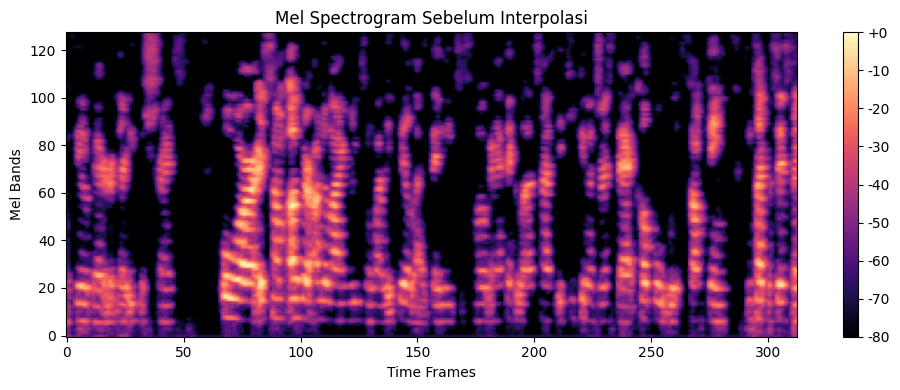

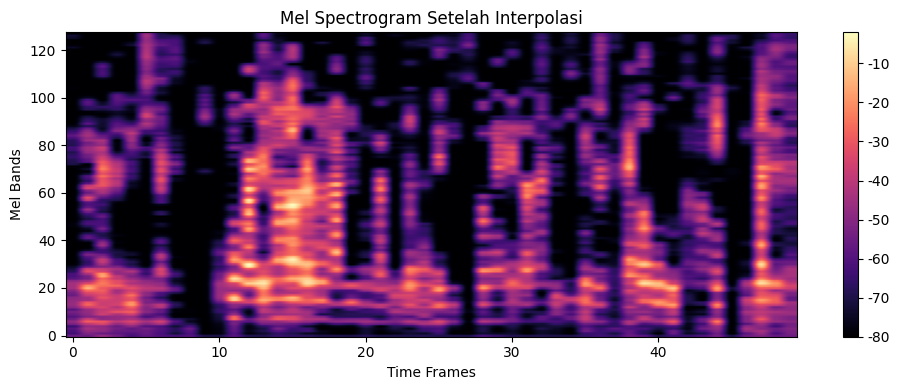

→ LIP-SYNC DEEPFAKE (violations: 2)
rslxpafeir.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


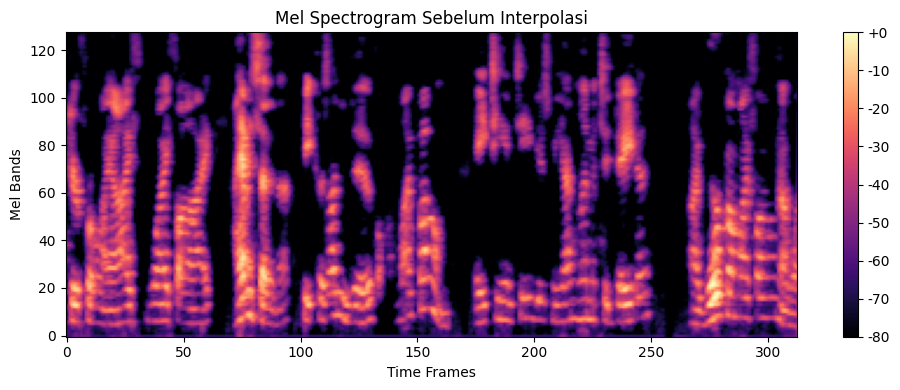

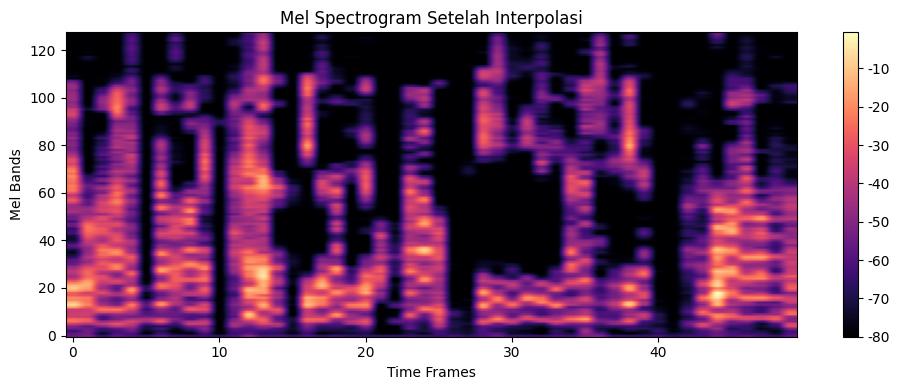

→ REAL (violations: 1)
rslxpafeir_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL


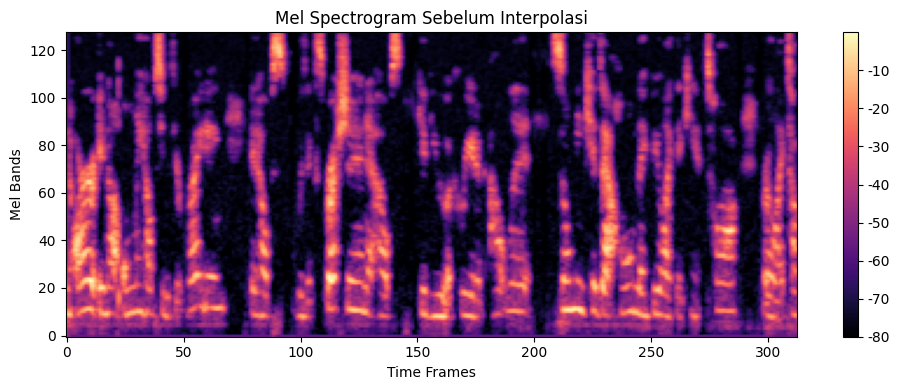

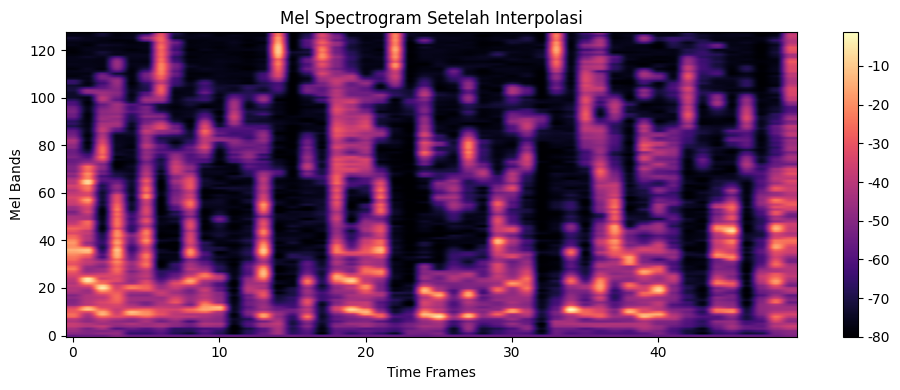

→ LIP-SYNC DEEPFAKE (violations: 2)
sailncwlmk.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


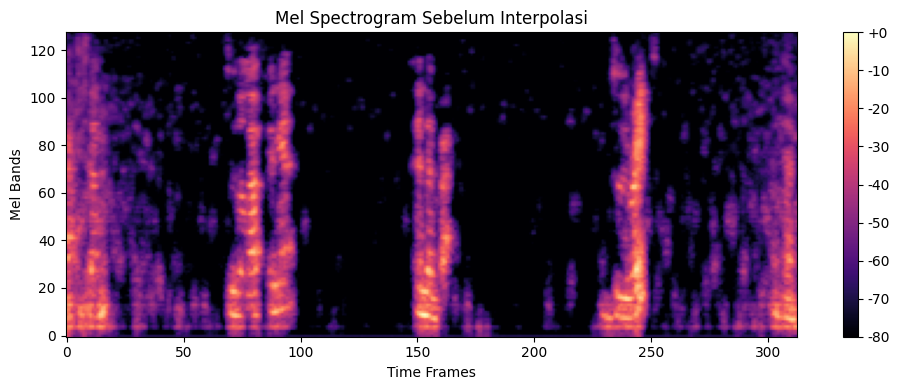

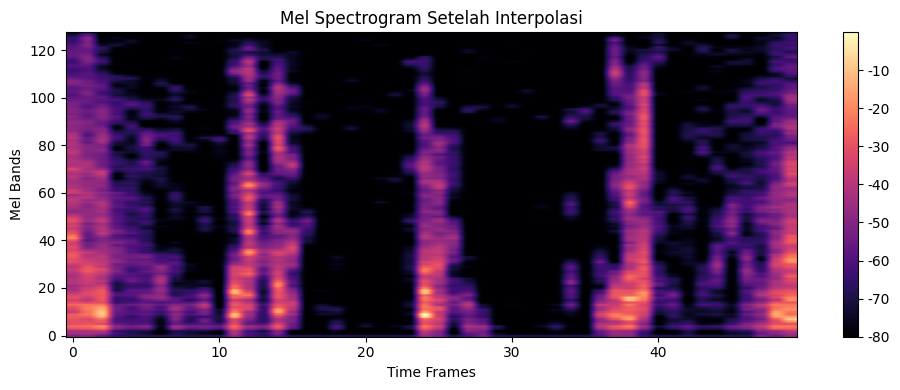

→ LIP-SYNC DEEPFAKE (violations: 2)
sailncwlmk_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] Dataset/testing\scrogtfgmn.mp4: hanya 47 landmark < seharusnya 50
scrogtfgmn.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\scrogtfgmn_lipsync.mp4: hanya 46 landmark < seharusnya 49
scrogtfgmn_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED


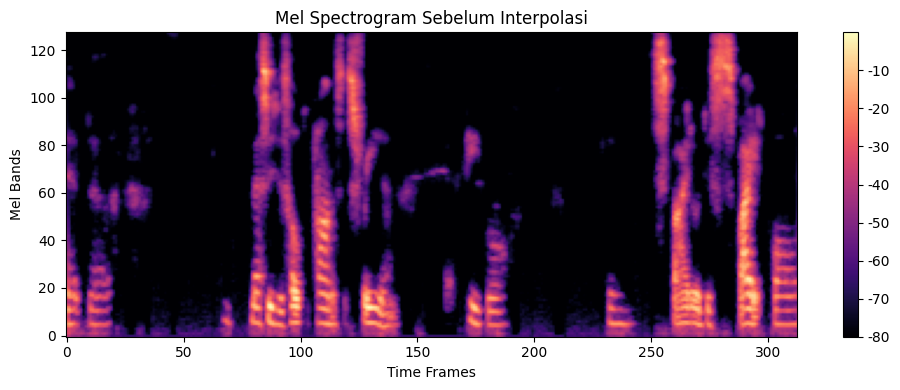

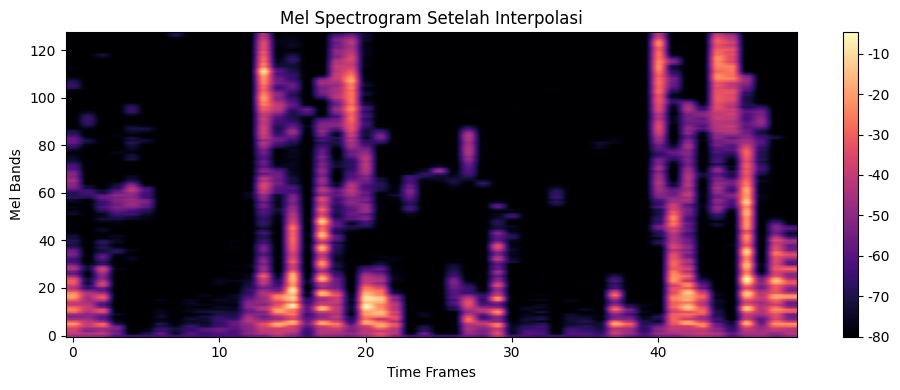

→ LIP-SYNC DEEPFAKE (violations: 7)
sfslnpbvtq.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


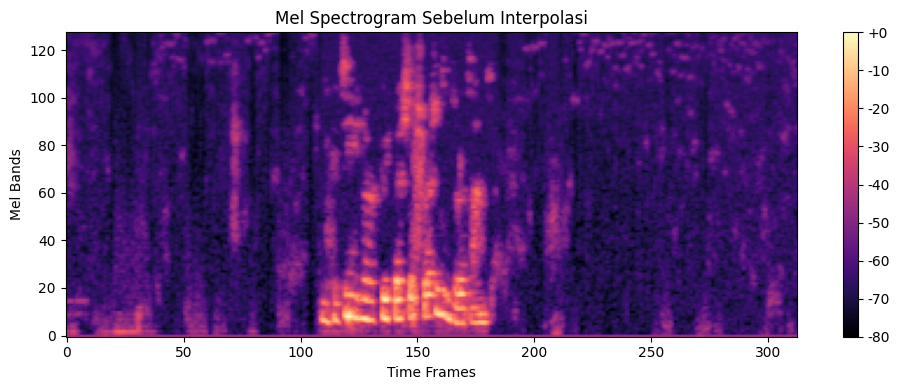

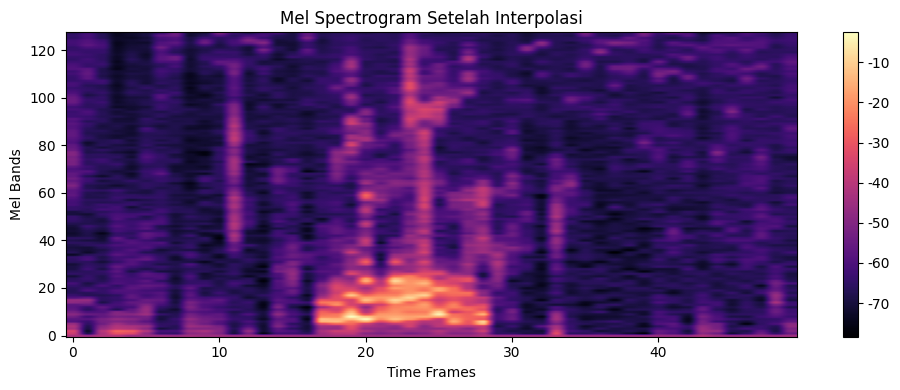

→ LIP-SYNC DEEPFAKE (violations: 5)
sfslnpbvtq_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] Dataset/testing\sscrakrzom.mp4: hanya 49 landmark < seharusnya 50
sscrakrzom.mp4 | GT: REAL | Pred: SKIPPED


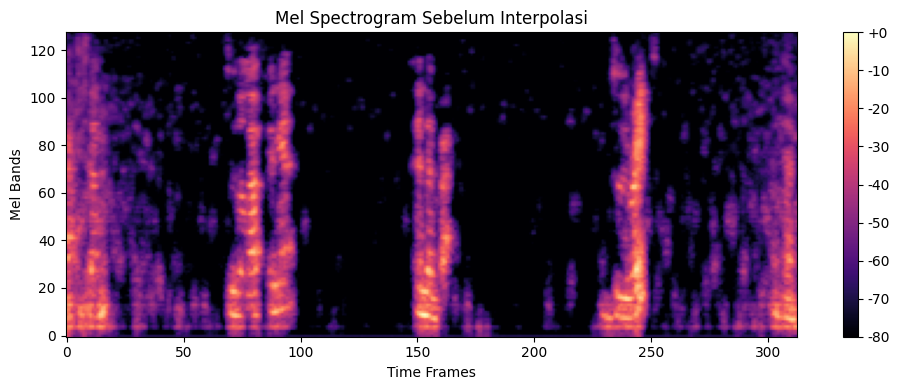

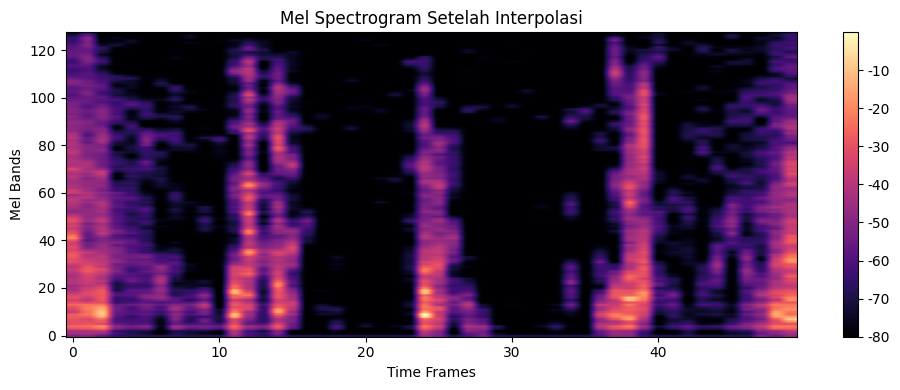

→ LIP-SYNC DEEPFAKE (violations: 2)
sscrakrzom_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] Dataset/testing\szwhgmrrhm.mp4: hanya 43 landmark < seharusnya 50
szwhgmrrhm.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\szwhgmrrhm_lipsync.mp4: hanya 43 landmark < seharusnya 50
szwhgmrrhm_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED
[SKIP] tamazprxch.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


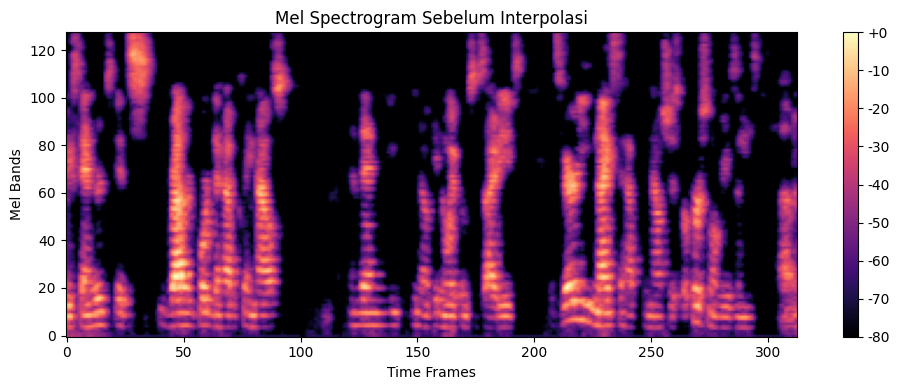

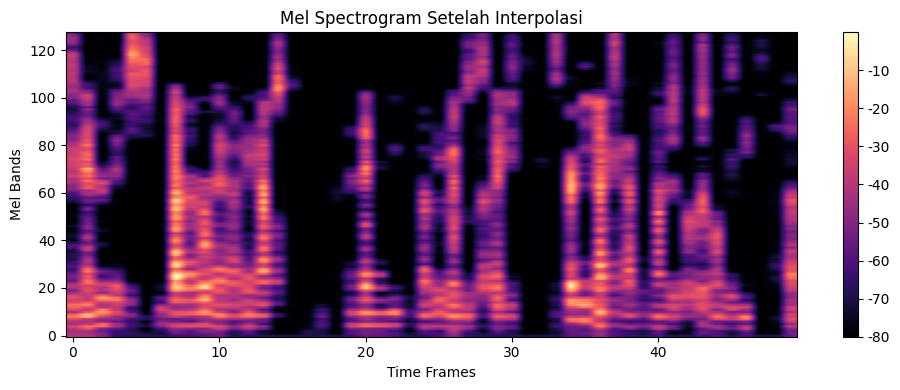

→ LIP-SYNC DEEPFAKE (violations: 3)
tdrraoezra.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


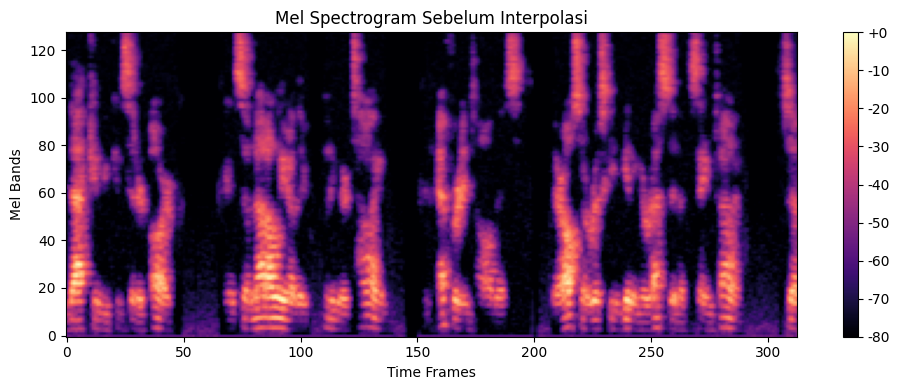

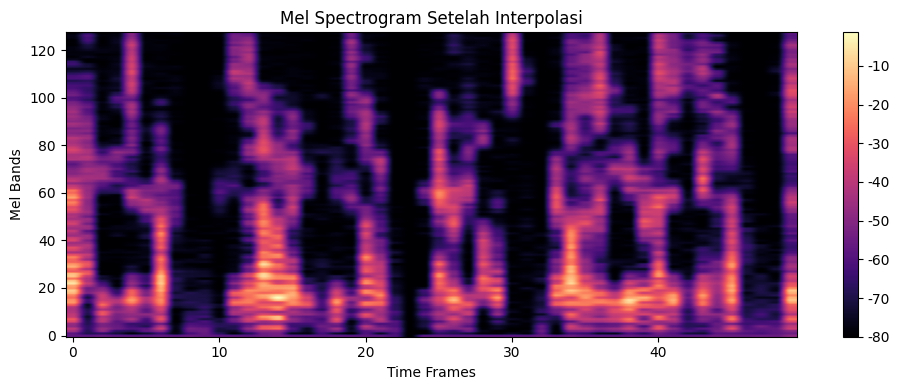

→ LIP-SYNC DEEPFAKE (violations: 2)
tdrraoezra_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] tmhvwyjjou.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] frame 0: belum ada wajah valid
[SKIP] frame 6: belum ada wajah valid
[SKIP] frame 12: belum ada wajah valid
[SKIP] frame 18: belum ada wajah valid
[SKIP] frame 24: belum ada wajah valid
[SKIP] frame 30: belum ada wajah valid
[SKIP] frame 36: belum ada wajah valid
[SKIP] frame 42: belum ada wajah valid
[SKIP] frame 48: belum ada wajah valid
[SKIP] frame 55: belum ada wajah valid
[SKIP] frame 61: belum ada wajah valid
[SKIP] frame 67: belum ada wajah valid
[SKIP] frame 73: belum ada wajah valid
[SKIP] frame 79: belum ada wajah valid
[SKIP] frame 85: belum ada wajah valid
[SKIP] frame 91: belum ada wajah valid
[SKIP] frame 97: belum ada wajah valid
[SKIP] frame 104: belum ada wajah valid
[SKIP] frame 110: belum ada wajah valid
[SKIP] frame 116: belum ada wajah valid
[SKIP] frame 122: belum ada wajah vali

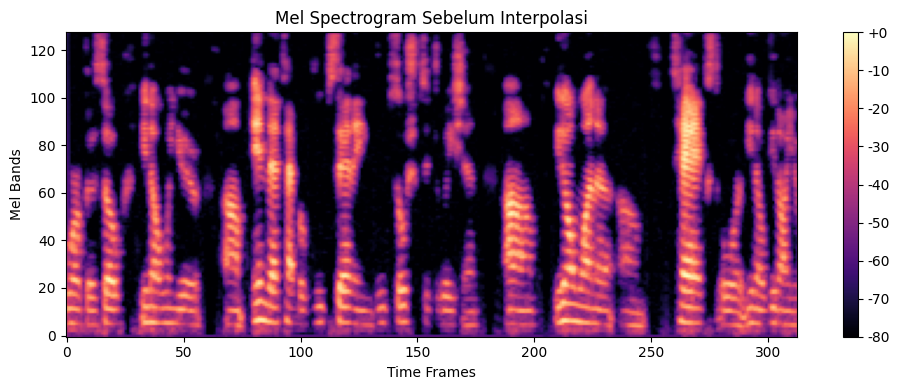

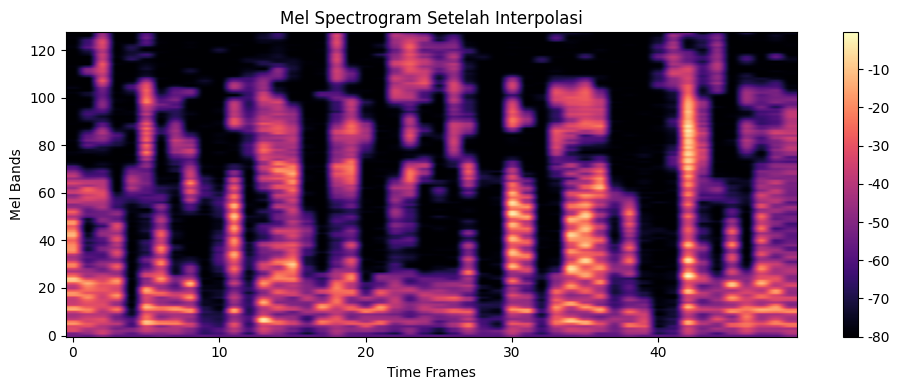

[SKIP] Tidak ada landmark valid.
tmpzveqsou.mp4 | GT: REAL | Pred: ERROR
[SKIP] frame 0: belum ada wajah valid
[SKIP] frame 6: belum ada wajah valid
[SKIP] frame 12: belum ada wajah valid
[SKIP] frame 18: belum ada wajah valid
[SKIP] frame 24: belum ada wajah valid
[SKIP] frame 30: belum ada wajah valid
[SKIP] frame 36: belum ada wajah valid
[SKIP] frame 42: belum ada wajah valid
[SKIP] frame 48: belum ada wajah valid
[SKIP] frame 55: belum ada wajah valid
[SKIP] frame 61: belum ada wajah valid
[SKIP] frame 67: belum ada wajah valid
[SKIP] frame 73: belum ada wajah valid
[SKIP] frame 79: belum ada wajah valid
[SKIP] frame 85: belum ada wajah valid
[SKIP] frame 91: belum ada wajah valid
[SKIP] frame 97: belum ada wajah valid
[SKIP] frame 104: belum ada wajah valid
[SKIP] frame 110: belum ada wajah valid
[SKIP] frame 116: belum ada wajah valid
[SKIP] frame 122: belum ada wajah valid
[SKIP] frame 128: belum ada wajah valid
[SKIP] frame 134: belum ada wajah valid
[SKIP] frame 140: belum ad

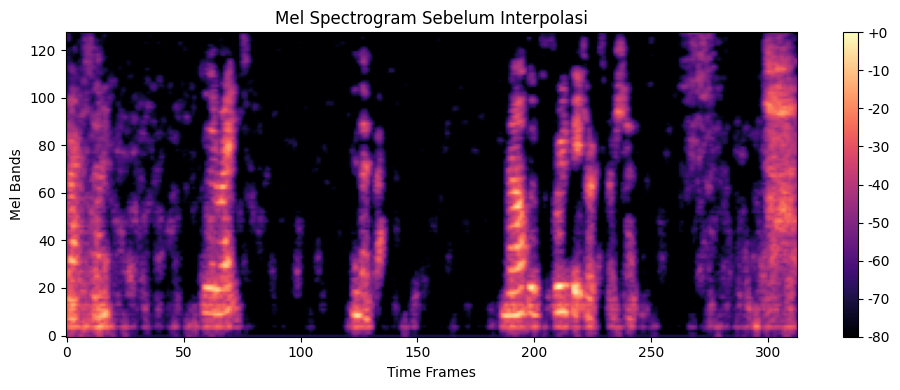

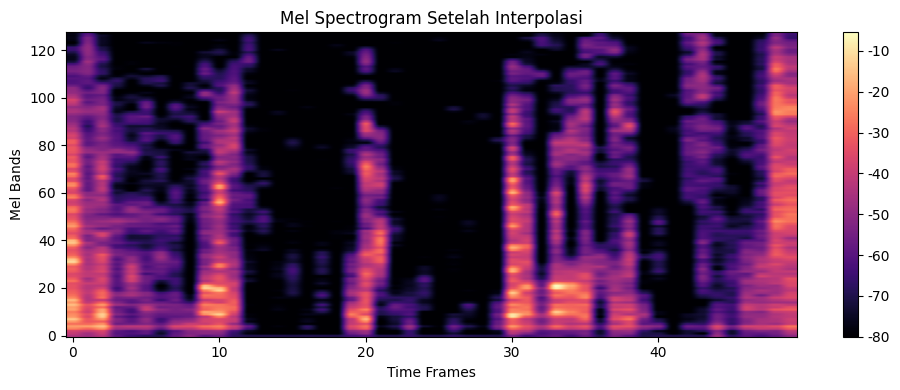

[SKIP] Tidak ada landmark valid.
tmpzveqsou_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: ERROR
[SKIP] ttuihqevkr.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


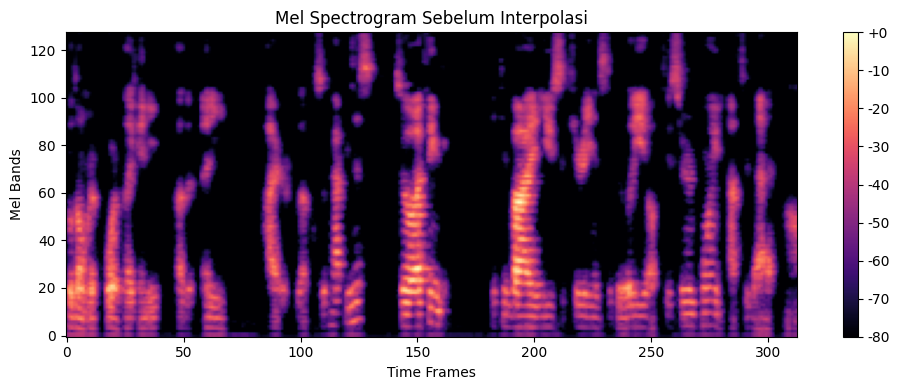

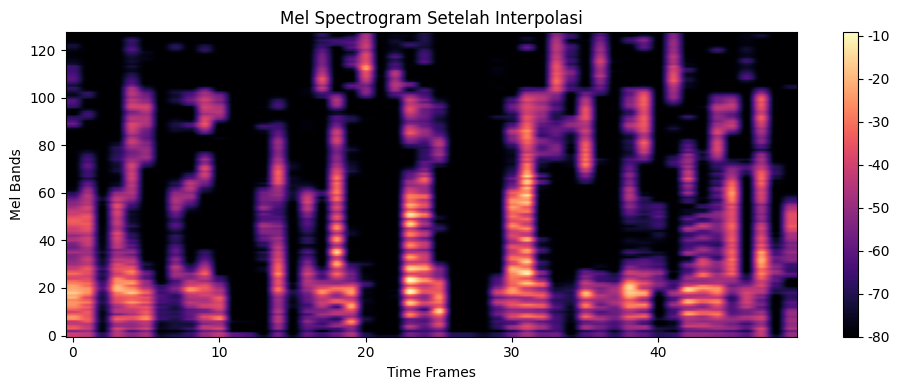

→ LIP-SYNC DEEPFAKE (violations: 2)
ubbzrfgzer.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


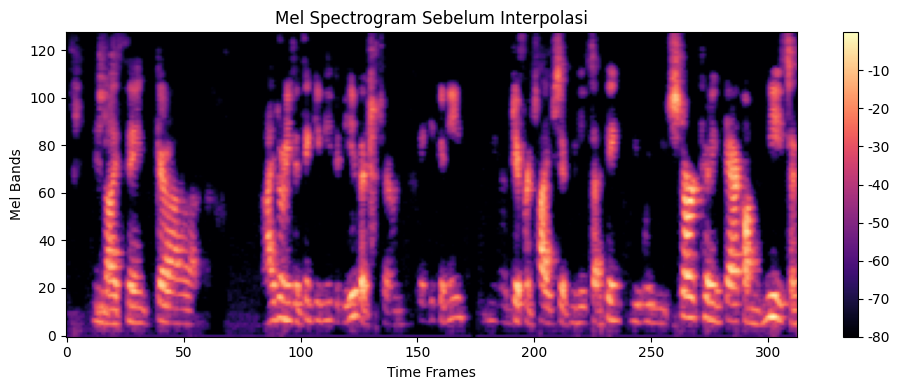

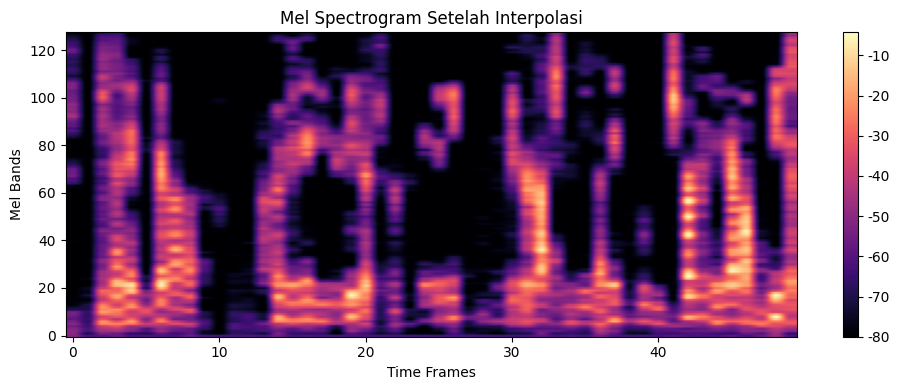

→ LIP-SYNC DEEPFAKE (violations: 2)
ubbzrfgzer_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE


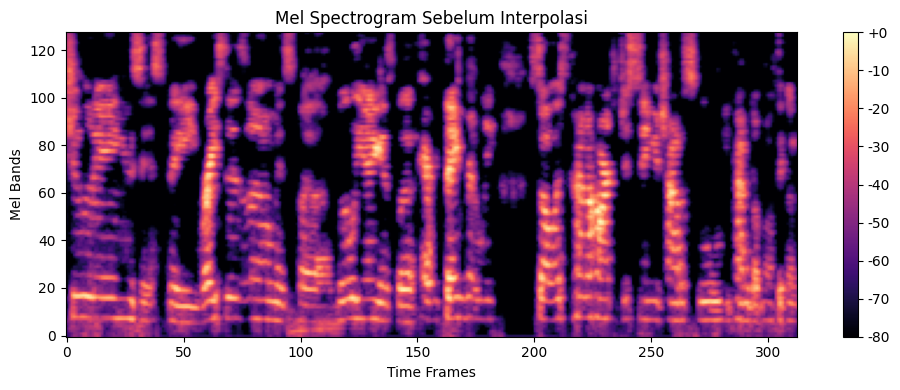

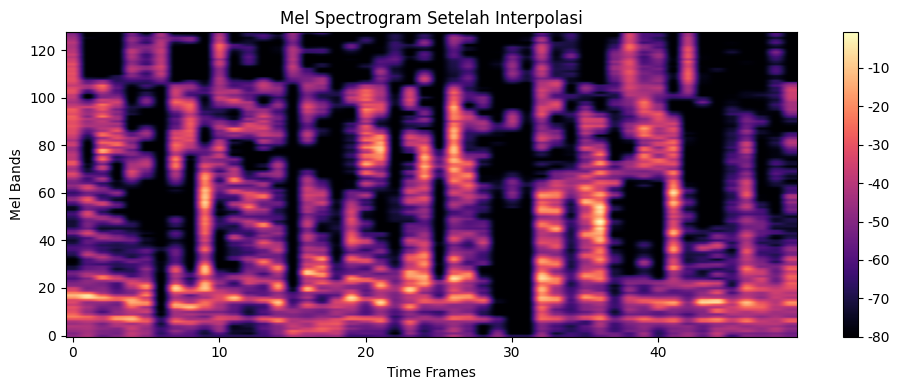

→ REAL (violations: 0)
uwjbwegyfx.mp4 | GT: REAL | Pred: REAL


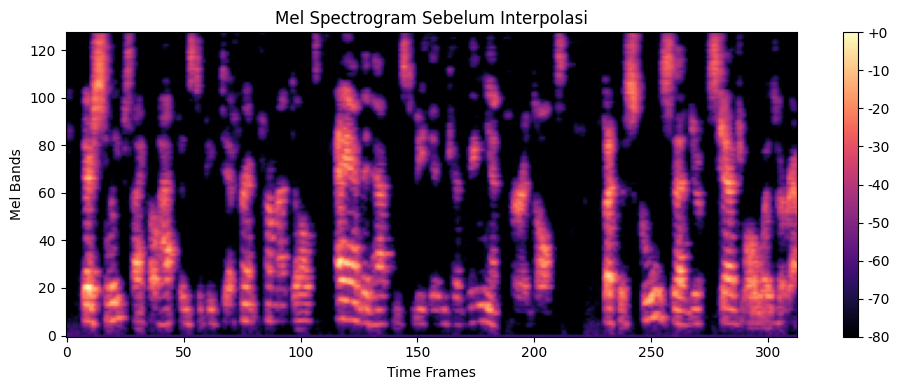

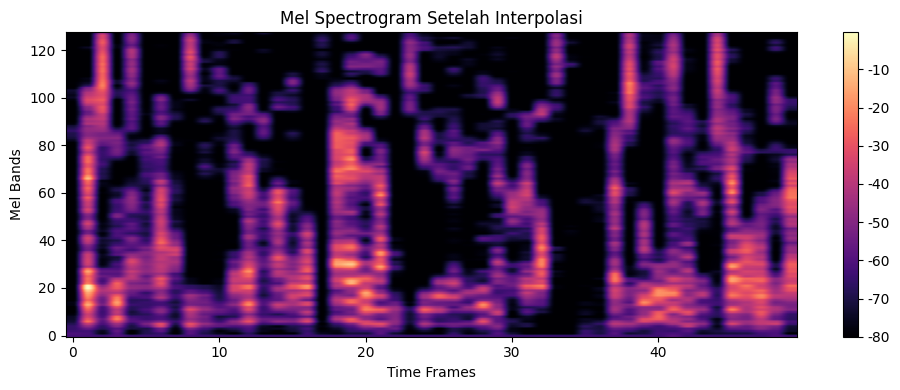

→ REAL (violations: 0)
uwjbwegyfx_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] frame 0: belum ada wajah valid
[SKIP] frame 6: belum ada wajah valid
[SKIP] frame 12: belum ada wajah valid
[SKIP] frame 18: belum ada wajah valid
[SKIP] frame 24: belum ada wajah valid
[SKIP] frame 30: belum ada wajah valid
[SKIP] frame 36: belum ada wajah valid
[SKIP] frame 42: belum ada wajah valid
[SKIP] frame 48: belum ada wajah valid
[SKIP] Dataset/testing\vddzflpeat.mp4: hanya 12 landmark < seharusnya 50
vddzflpeat.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] frame 0: belum ada wajah valid
[SKIP] frame 6: belum ada wajah valid
[SKIP] frame 12: belum ada wajah valid
[SKIP] frame 18: belum ada wajah valid
[SKIP] Dataset/testing\vddzflpeat_lipsync.mp4: hanya 14 landmark < seharusnya 50
vddzflpeat_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED
[SKIP] vyoozsirec.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


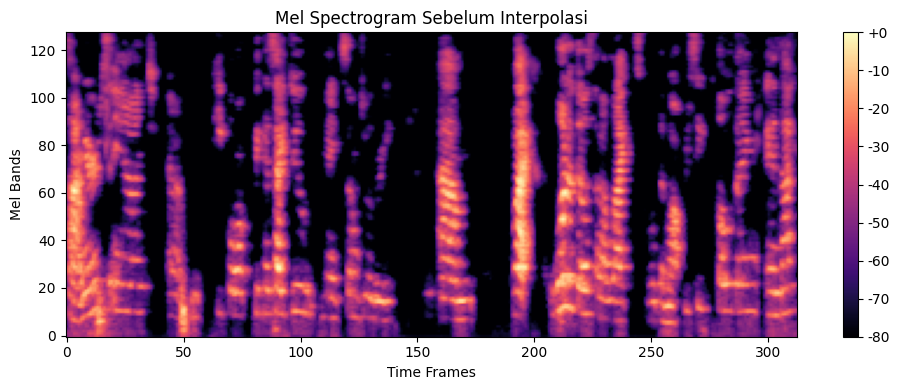

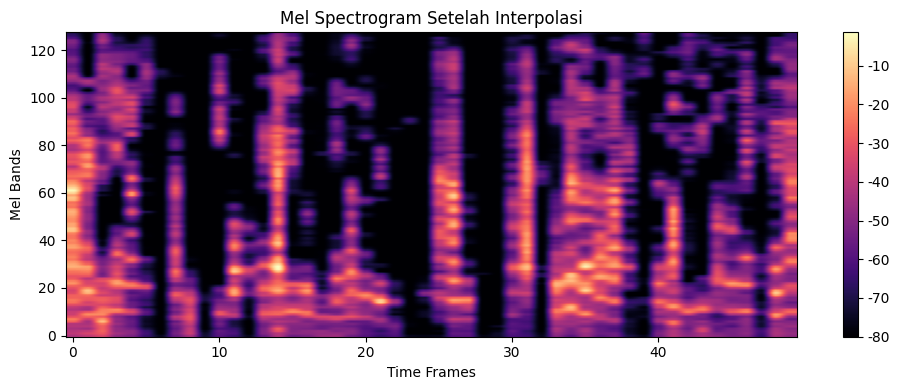

→ REAL (violations: 0)
wgycqahjww.mp4 | GT: REAL | Pred: REAL


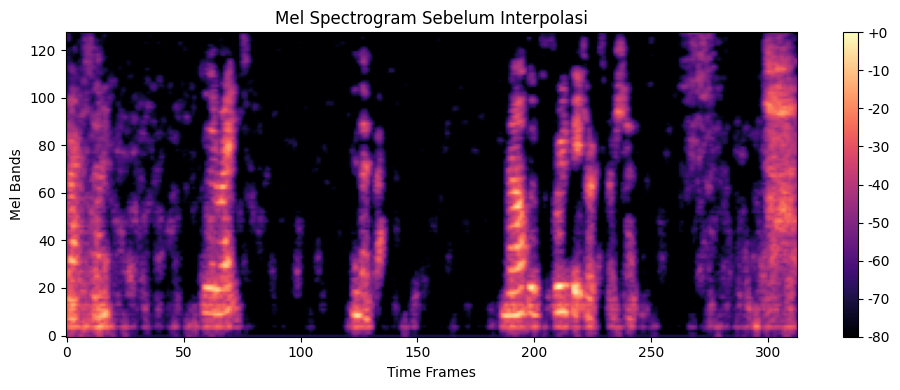

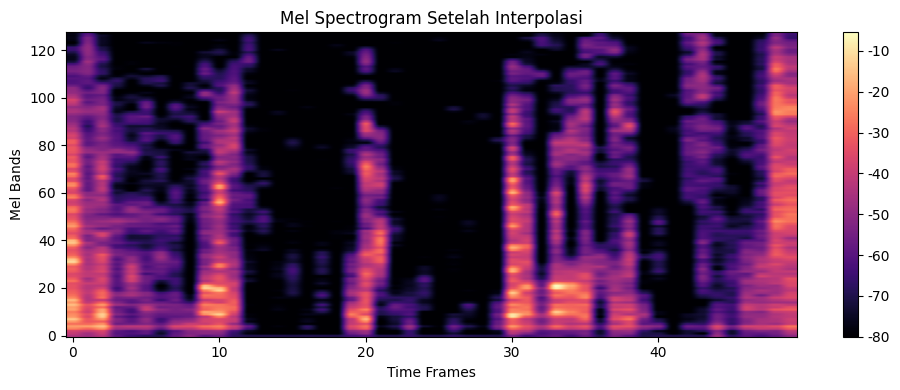

→ REAL (violations: 1)
wgycqahjww_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL


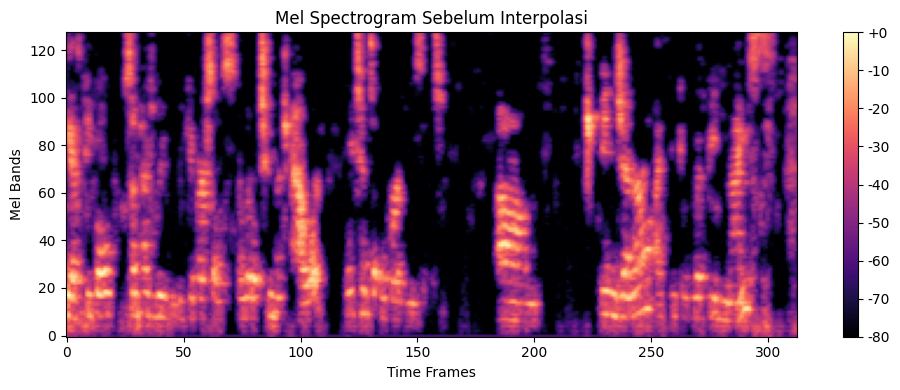

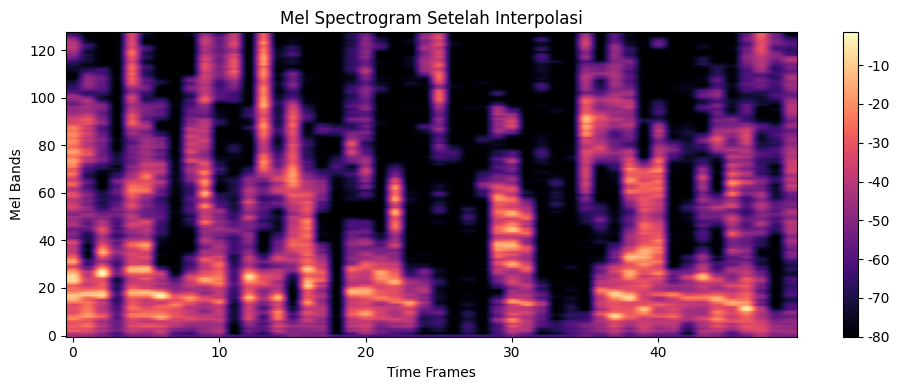

→ LIP-SYNC DEEPFAKE (violations: 3)
wunigwmyit.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


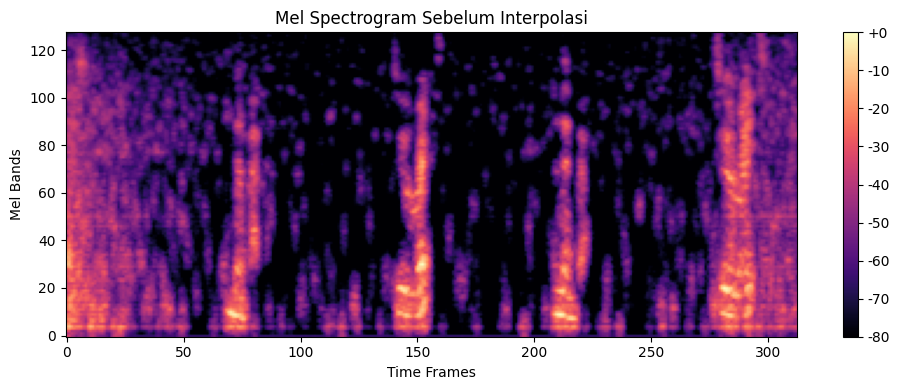

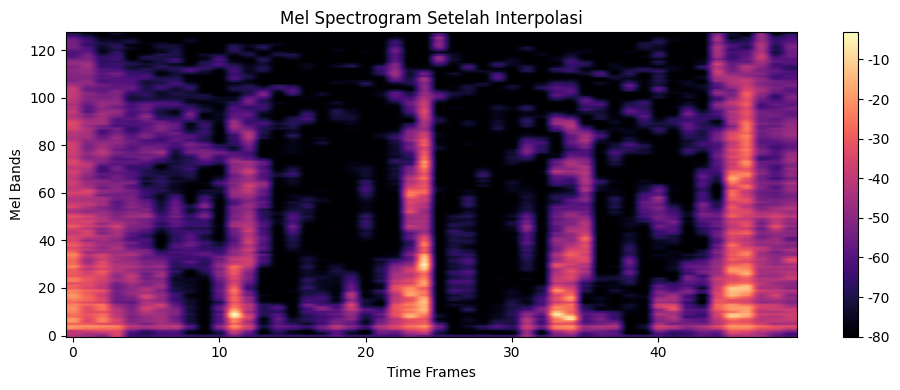

→ LIP-SYNC DEEPFAKE (violations: 4)
wunigwmyit_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE
[SKIP] xcihypsuad.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


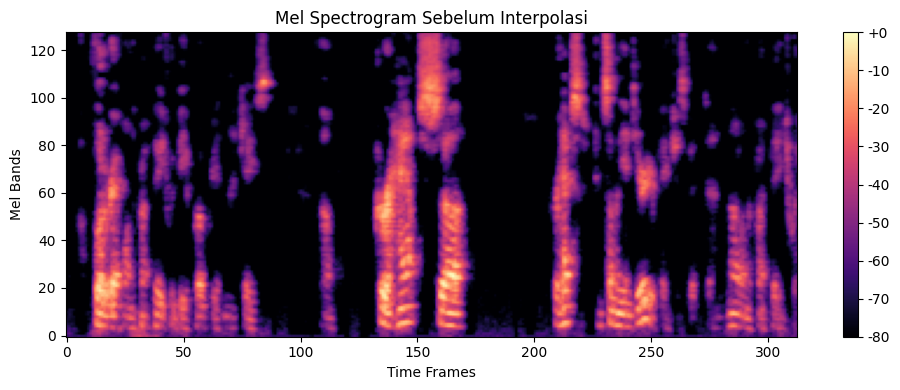

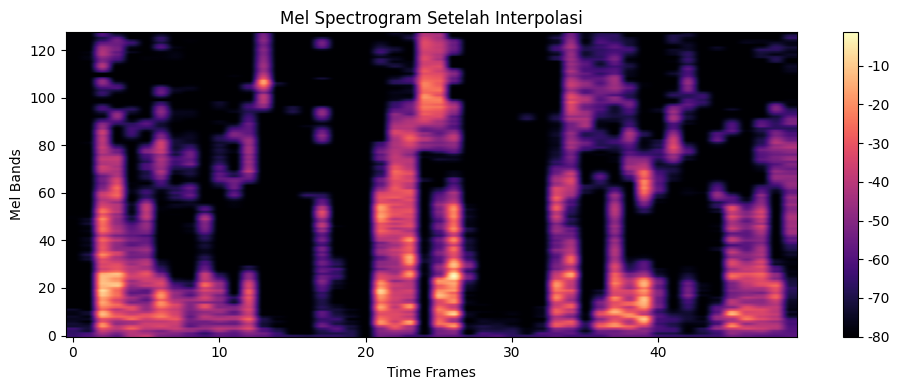

→ LIP-SYNC DEEPFAKE (violations: 5)
xofswkdrvb.mp4 | GT: REAL | Pred: LIP-SYNC DEEPFAKE


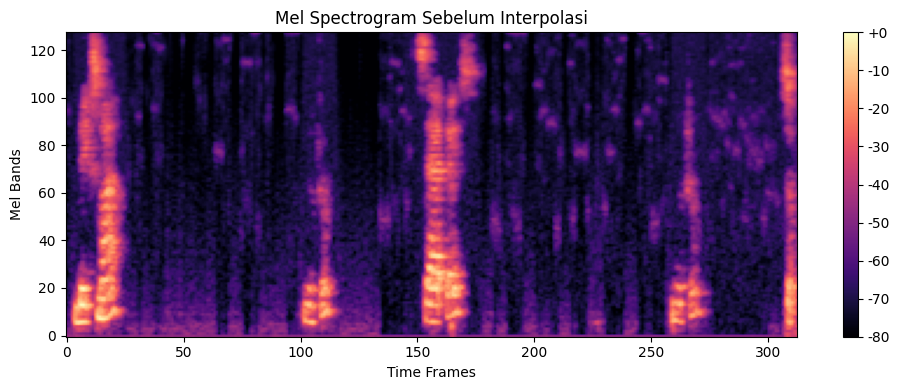

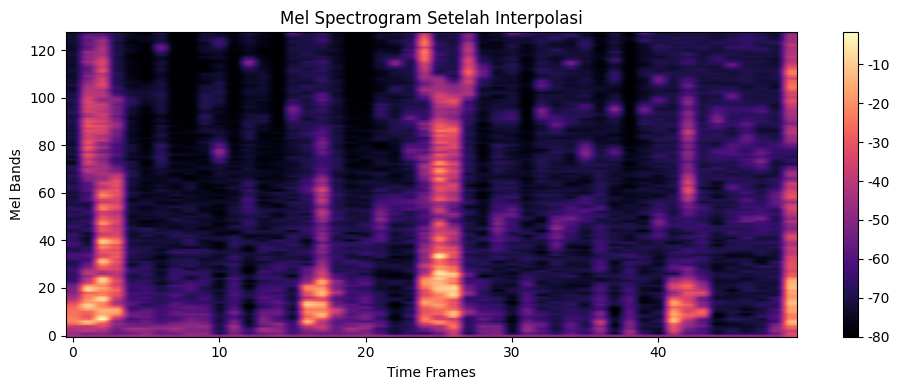

→ LIP-SYNC DEEPFAKE (violations: 4)
xofswkdrvb_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE


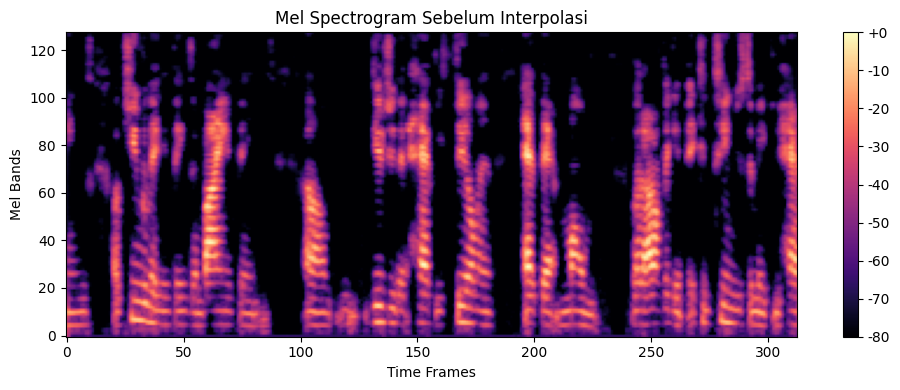

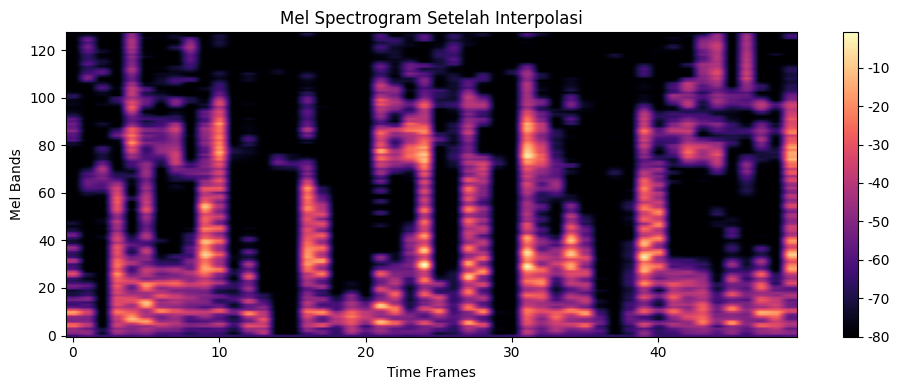

→ REAL (violations: 1)
yfnalahkmb.mp4 | GT: REAL | Pred: REAL


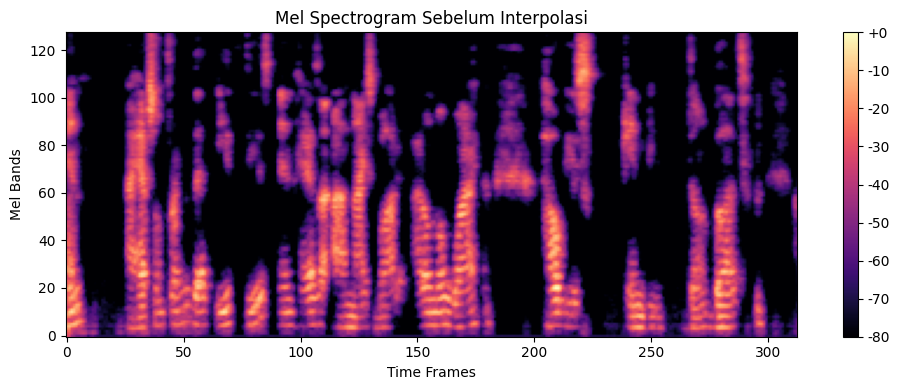

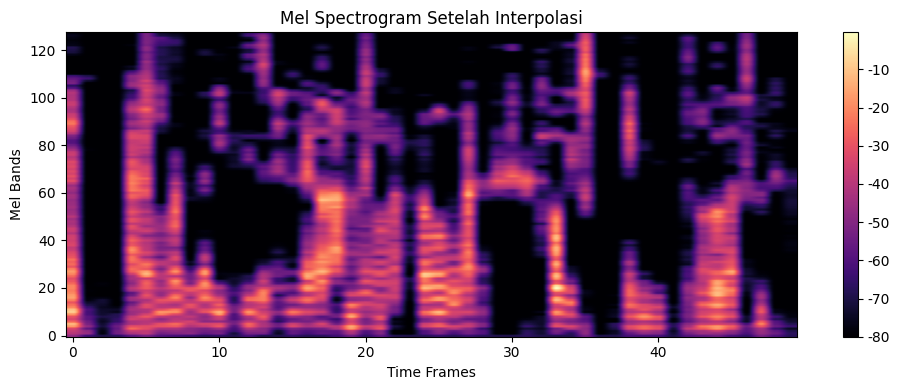

→ REAL (violations: 0)
yfnalahkmb_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] ygrgmlnddj.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.


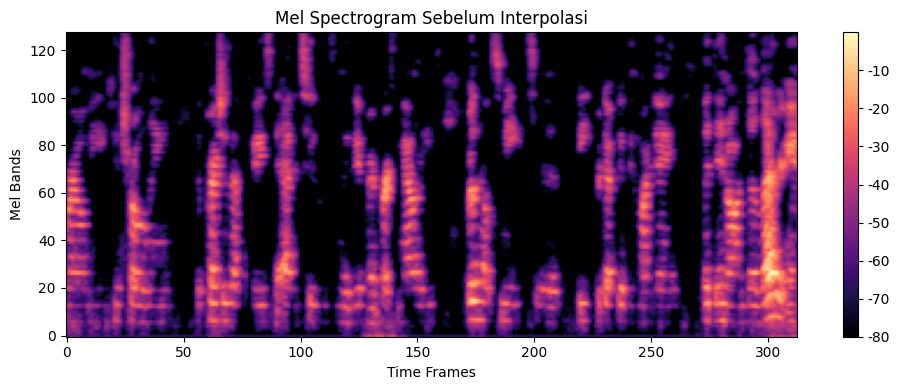

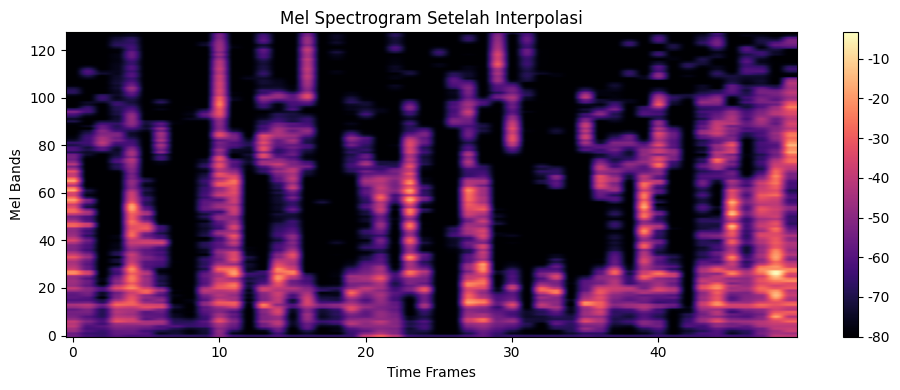

→ REAL (violations: 0)
ynmluajwre.mp4 | GT: REAL | Pred: REAL


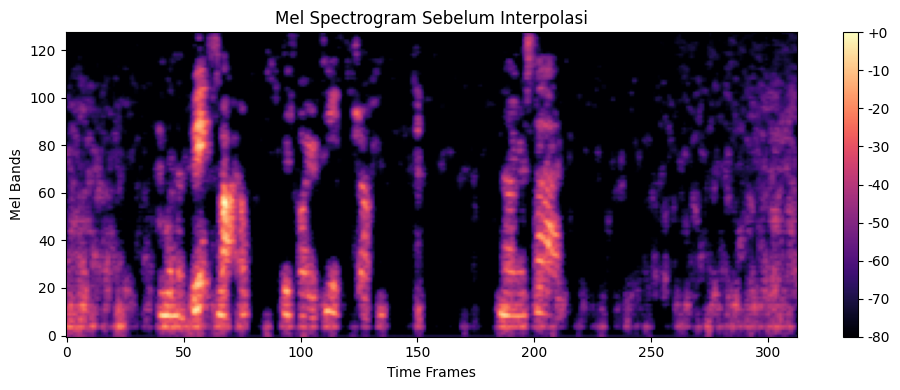

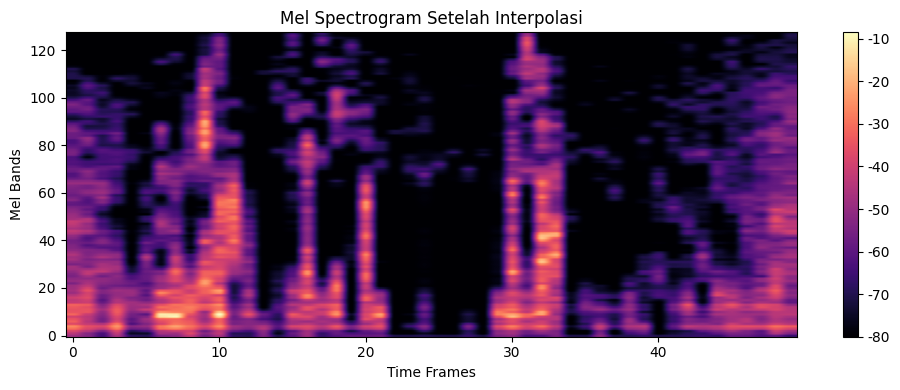

→ LIP-SYNC DEEPFAKE (violations: 2)
ynmluajwre_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: LIP-SYNC DEEPFAKE


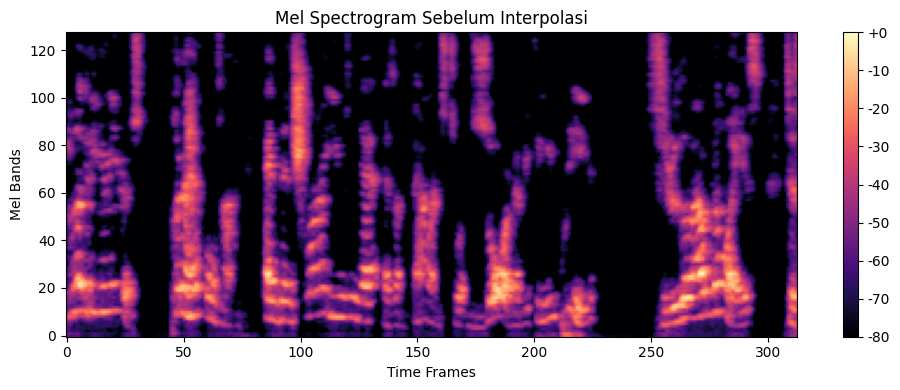

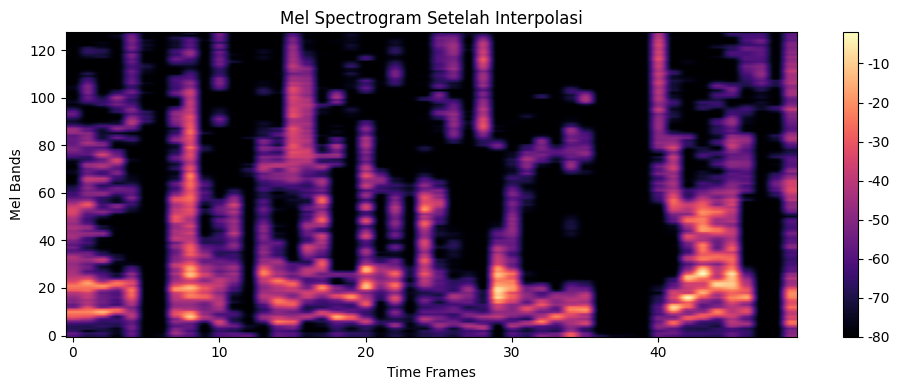

→ REAL (violations: 0)
yvfoaoiclp.mp4 | GT: REAL | Pred: REAL


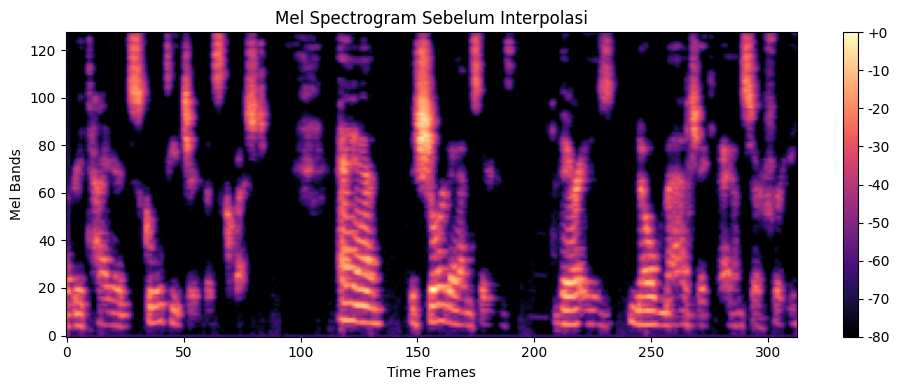

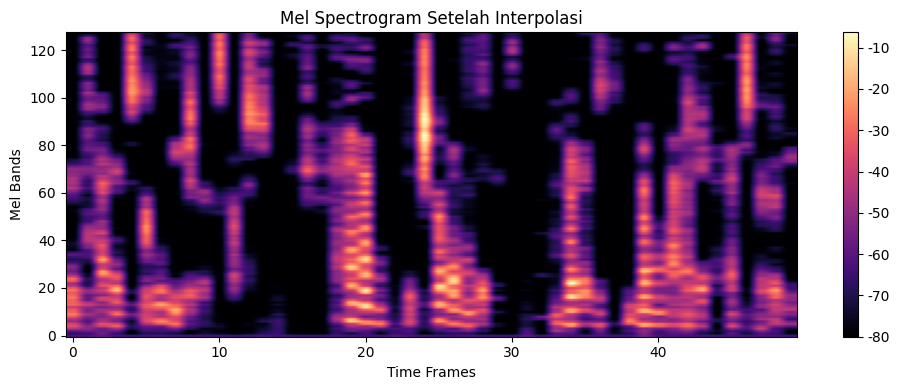

→ REAL (violations: 1)
yvfoaoiclp_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: REAL
[SKIP] yvnlaygbkm.mp4 label 'FACE-SWAP DEEPFAKE' bukan target evaluasi.
[SKIP] Dataset/testing\zyfxvtxrsk.mp4: hanya 47 landmark < seharusnya 50
zyfxvtxrsk.mp4 | GT: REAL | Pred: SKIPPED
[SKIP] Dataset/testing\zyfxvtxrsk_lipsync.mp4: hanya 45 landmark < seharusnya 49
zyfxvtxrsk_lipsync.mp4 | GT: LIP-SYNC DEEPFAKE | Pred: SKIPPED

✅ Akurasi Prediksi Sinkronisasi: 35.00% (35/100 benar)


In [32]:
results = evaluate_folder_lipsync_sync(
    video_folder="Dataset/testing",
    metadata_path="Dataset/testing/metadata.json",
    fps=5
)